In [1]:
import numpy as np
import copy
import matplotlib.pyplot as plt
import pickle
import random
import torch
from utils import torch_from_numpy
import datetime

bif_c = 0.1
num_iter_max=200000
alpha=0.2
# alpha=0.5
# alpha=0.8 # predict diverge
# vae_lr=1e-5
vae_lr=5e-4
ratio_lr=5e-4
ratio_early=100
env_name = 'CustomPendulum-v0'

loss_list = []
normalized_loss_list = []

In [2]:
import gym
import custom_gym
env = gym.make(env_name)

seed = 0
env.seed(seed)
env.action_space.seed(seed)
torch.manual_seed(seed)
np.random.seed(seed)
random.seed(seed)

s_dim = env.reset().flatten().shape[0]
a_dim = env.action_space.sample().flatten().shape[0]
z_dim = 1
print(s_dim, a_dim, z_dim)



2 1 1


/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/core.py:329: DeprecationWarning: WARN: Initializing wrapper in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/wrappers/step_api_compatibility.py:39: DeprecationWarning: WARN: Initializing environment in old step API which returns one bool instead of two. It is recommended to set `new_step_api=True` to use new step API. This will be the default behaviour in future.
  deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:174: UserWarning: WARN: Future gym versions will require that `Env.reset` can be passed a `seed` instead of using `Env.seed` for resetting the environment random number generator.
  logger.warn(
/home/proxima-hishinuma/anaconda3/

In [3]:


from sac import SAC
agent = SAC(env.observation_space.shape[0], env.action_space)
agent.load_checkpoint(ckpt_path="checkpoints/sac_checkpoint_custom_pendulum_mdp_")


offline_data = pickle.load(open("offline_data.pkl","rb"))
debug_info = pickle.load(open("offline_data_debug_info.pkl","rb"))
debug_info = np.array(debug_info)

Loading models from checkpoints/sac_checkpoint_custom_pendulum_mdp_


In [4]:
args_init_dict = {"offline_data": offline_data,
             "s_dim": s_dim,
             "a_dim": a_dim,
             "z_dim": z_dim,
#              "policy":agent.select_action,
             "mdp_policy":agent.policy.my_np_select_action,
                  "debug_info":debug_info,
                  "env" : env}
# import vi_base
# vi = vi_base.baseVI(args_init_dict)
import vi_iw
iwvi = vi_iw.iwVI(args_init_dict)

iwvi.load_base()
iwvi.update_mulogvar_offlinedata()

load vi_base_ckpt


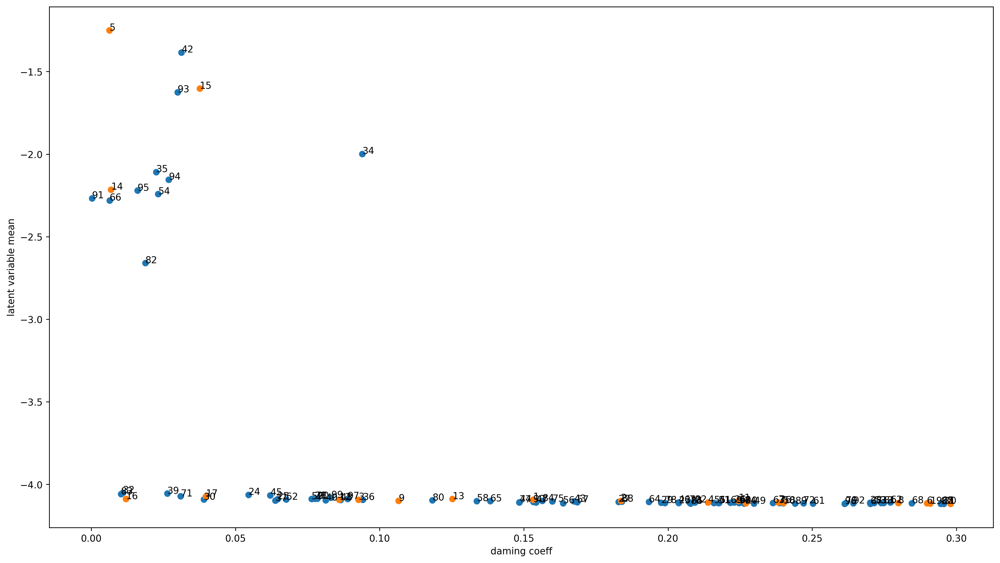

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [5]:
plt.figure(figsize=(18,10), dpi=250)
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()
plt.xlabel("daming coeff")
plt.ylabel("latent variable mean")

plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.xlim([-0.05,0.35])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent_iter0.png")
plt.savefig("damping_latent_iter0.eps")
plt.savefig("damping_latent_iter0.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.xlim([0.06,0.14])
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [6]:
iwvi.get_real_rollout_mdppolicy_data()

0  1  2  

/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:227: DeprecationWarning: WARN: Core environment is written in old step API which returns one bool instead of two. It is recommended to rewrite the environment with new step API. 
  logger.deprecation(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:233: DeprecationWarning: `np.bool8` is a deprecated alias for `np.bool_`.  (Deprecated NumPy 1.24)
  if not isinstance(done, (bool, np.bool8)):
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:141: UserWarning: WARN: The obs returned by the `step()` method was expecting numpy array dtype to be float32, actual type: float64
  logger.warn(
/home/proxima-hishinuma/anaconda3/envs/iwvi/lib/python3.8/site-packages/gym/utils/passive_env_checker.py:165: UserWarning: WARN: The obs returned by the `step()` method is not within the observ

3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [7]:
# fig = plt.figure(figsize=(18,10))
# ax_list = []
# for i in range(50):
#     ax_list.append(fig.add_subplot(5, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1]) 
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1]) 
# print("オフラインデータvs実環境方策rollout")

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  predict diverge [   7.74578972 -150.78676298]
43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  predict 

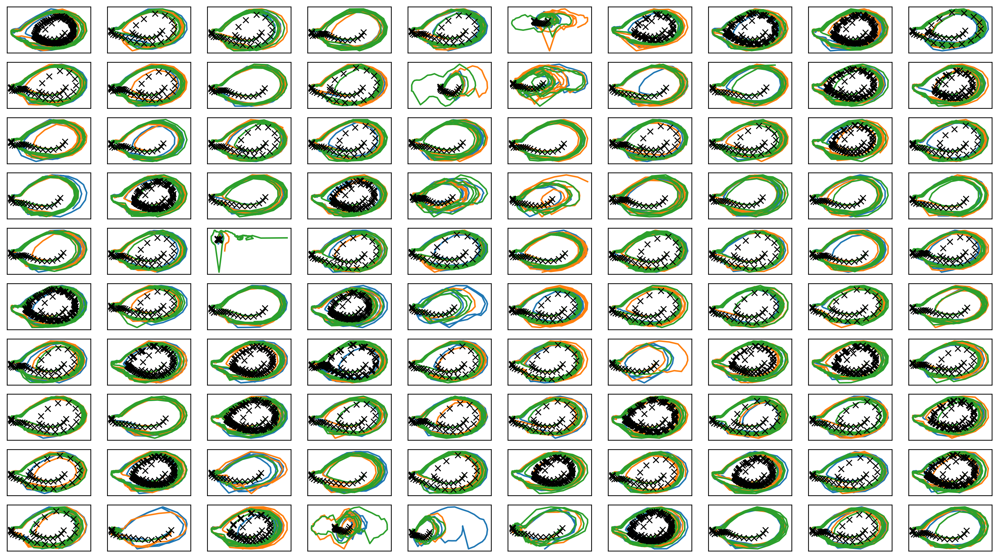

In [8]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter0.png")
plt.savefig("joint_iter0.eps")
plt.savefig("joint_iter0.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

In [9]:
print(datetime.datetime.now())

2023-03-19 14:40:40.607990


# Iter 1

In [10]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  predict diverge [173.67771024  81.36971826]
predict diverge [ 93.67361323 102.56857841]
6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [11]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 1.36849  validloss 1.46689±0.00000  bestvalidloss 1.46689  last_update 0
train: iter 1  trainloss 1.12927  validloss 1.27292±0.00000  bestvalidloss 1.27292  last_update 0
train: iter 2  trainloss 0.89914  validloss 1.00881±0.00000  bestvalidloss 1.00881  last_update 0
train: iter 3  trainloss 0.77985  validloss 0.85321±0.00000  bestvalidloss 0.85321  last_update 0
train: iter 4  trainloss 0.71586  validloss 0.77797±0.00000  bestvalidloss 0.77797  last_update 0
train: iter 5  trainloss 0.67478  validloss 0.72932±0.00000  bestvalidloss 0.72932  last_update 0
train: iter 6  trainloss 0.63796  validloss 0.68879±0.00000  bestvalidloss 0.68879  last_update 0
train: iter 7  trainloss 0.60426  validloss 0.64664±0.00000  bestvalidloss 0.64664  last_update 0
train: iter 8  trainloss 0.56912  validloss 0.60693±0.00000  bestvalidloss 0.60693  last_update 0
train: iter 9  trainloss 0.54032  validloss 0.57289±0.00000  bestvalidloss 0.57289  last_update 0
train: iter 10  trai

train: iter 84  trainloss 0.19980  validloss 0.25653±0.00000  bestvalidloss 0.25653  last_update 0
train: iter 85  trainloss 0.19953  validloss 0.25566±0.00000  bestvalidloss 0.25566  last_update 0
train: iter 86  trainloss 0.19742  validloss 0.25871±0.00000  bestvalidloss 0.25566  last_update 1
train: iter 87  trainloss 0.19696  validloss 0.25670±0.00000  bestvalidloss 0.25566  last_update 2
train: iter 88  trainloss 0.19499  validloss 0.25671±0.00000  bestvalidloss 0.25566  last_update 3
train: iter 89  trainloss 0.19478  validloss 0.25585±0.00000  bestvalidloss 0.25566  last_update 4
train: iter 90  trainloss 0.19567  validloss 0.25842±0.00000  bestvalidloss 0.25566  last_update 5
train: iter 91  trainloss 0.19319  validloss 0.25499±0.00000  bestvalidloss 0.25499  last_update 0
train: iter 92  trainloss 0.19327  validloss 0.25530±0.00000  bestvalidloss 0.25499  last_update 1
train: iter 93  trainloss 0.19166  validloss 0.25570±0.00000  bestvalidloss 0.25499  last_update 2
train: ite

train: iter 167  trainloss 0.16227  validloss 0.23810±0.00000  bestvalidloss 0.23810  last_update 0
train: iter 168  trainloss 0.16078  validloss 0.23783±0.00000  bestvalidloss 0.23783  last_update 0
train: iter 169  trainloss 0.16462  validloss 0.23867±0.00000  bestvalidloss 0.23783  last_update 1
train: iter 170  trainloss 0.16002  validloss 0.23763±0.00000  bestvalidloss 0.23763  last_update 0
train: iter 171  trainloss 0.16000  validloss 0.23942±0.00000  bestvalidloss 0.23763  last_update 1
train: iter 172  trainloss 0.16131  validloss 0.23413±0.00000  bestvalidloss 0.23413  last_update 0
train: iter 173  trainloss 0.15968  validloss 0.23686±0.00000  bestvalidloss 0.23413  last_update 1
train: iter 174  trainloss 0.16056  validloss 0.23479±0.00000  bestvalidloss 0.23413  last_update 2
train: iter 175  trainloss 0.16234  validloss 0.24908±0.00000  bestvalidloss 0.23413  last_update 3
train: iter 176  trainloss 0.15956  validloss 0.23589±0.00000  bestvalidloss 0.23413  last_update 4


train: iter 250  trainloss 0.14597  validloss 0.22215±0.00000  bestvalidloss 0.21911  last_update 2
train: iter 251  trainloss 0.14559  validloss 0.22695±0.00000  bestvalidloss 0.21911  last_update 3
train: iter 252  trainloss 0.14412  validloss 0.21891±0.00000  bestvalidloss 0.21891  last_update 0
train: iter 253  trainloss 0.14338  validloss 0.22007±0.00000  bestvalidloss 0.21891  last_update 1
train: iter 254  trainloss 0.14821  validloss 0.22521±0.00000  bestvalidloss 0.21891  last_update 2
train: iter 255  trainloss 0.14390  validloss 0.21834±0.00000  bestvalidloss 0.21834  last_update 0
train: iter 256  trainloss 0.14330  validloss 0.22024±0.00000  bestvalidloss 0.21834  last_update 1
train: iter 257  trainloss 0.14445  validloss 0.21857±0.00000  bestvalidloss 0.21834  last_update 2
train: iter 258  trainloss 0.14275  validloss 0.21979±0.00000  bestvalidloss 0.21834  last_update 3
train: iter 259  trainloss 0.14200  validloss 0.21724±0.00000  bestvalidloss 0.21724  last_update 0


train: iter 332  trainloss 0.13090  validloss 0.21824±0.00000  bestvalidloss 0.21587  last_update 1
train: iter 333  trainloss 0.13125  validloss 0.21840±0.00000  bestvalidloss 0.21587  last_update 2
train: iter 334  trainloss 0.12947  validloss 0.21659±0.00000  bestvalidloss 0.21587  last_update 3
train: iter 335  trainloss 0.12956  validloss 0.21523±0.00000  bestvalidloss 0.21523  last_update 0
train: iter 336  trainloss 0.12863  validloss 0.21930±0.00000  bestvalidloss 0.21523  last_update 1
train: iter 337  trainloss 0.12887  validloss 0.21940±0.00000  bestvalidloss 0.21523  last_update 2
train: iter 338  trainloss 0.13052  validloss 0.21948±0.00000  bestvalidloss 0.21523  last_update 3
train: iter 339  trainloss 0.13078  validloss 0.21511±0.00000  bestvalidloss 0.21511  last_update 0
train: iter 340  trainloss 0.13245  validloss 0.22033±0.00000  bestvalidloss 0.21511  last_update 1
train: iter 341  trainloss 0.12803  validloss 0.21657±0.00000  bestvalidloss 0.21511  last_update 2


train: iter 416  trainloss 0.12006  validloss 0.21274±0.00000  bestvalidloss 0.20991  last_update 9
train: iter 417  trainloss 0.12039  validloss 0.21098±0.00000  bestvalidloss 0.20991  last_update 10
train: iter 418  trainloss 0.12060  validloss 0.21210±0.00000  bestvalidloss 0.20991  last_update 11
train: iter 419  trainloss 0.12038  validloss 0.21161±0.00000  bestvalidloss 0.20991  last_update 12
train: iter 420  trainloss 0.12051  validloss 0.21000±0.00000  bestvalidloss 0.20991  last_update 13
train: iter 421  trainloss 0.11928  validloss 0.21156±0.00000  bestvalidloss 0.20991  last_update 14
train: iter 422  trainloss 0.12044  validloss 0.21267±0.00000  bestvalidloss 0.20991  last_update 15
train: iter 423  trainloss 0.11946  validloss 0.21356±0.00000  bestvalidloss 0.20991  last_update 16
train: iter 424  trainloss 0.12038  validloss 0.21019±0.00000  bestvalidloss 0.20991  last_update 17
train: iter 425  trainloss 0.11959  validloss 0.20969±0.00000  bestvalidloss 0.20969  last_u

train: iter 499  trainloss 0.11393  validloss 0.20871±0.00000  bestvalidloss 0.20698  last_update 3
train: iter 500  trainloss 0.11369  validloss 0.20692±0.00000  bestvalidloss 0.20692  last_update 0
train: iter 501  trainloss 0.11299  validloss 0.21186±0.00000  bestvalidloss 0.20692  last_update 1
train: iter 502  trainloss 0.11486  validloss 0.20942±0.00000  bestvalidloss 0.20692  last_update 2
train: iter 503  trainloss 0.11394  validloss 0.20923±0.00000  bestvalidloss 0.20692  last_update 3
train: iter 504  trainloss 0.11462  validloss 0.21464±0.00000  bestvalidloss 0.20692  last_update 4
train: iter 505  trainloss 0.11449  validloss 0.20886±0.00000  bestvalidloss 0.20692  last_update 5
train: iter 506  trainloss 0.11517  validloss 0.21190±0.00000  bestvalidloss 0.20692  last_update 6
train: iter 507  trainloss 0.11471  validloss 0.20900±0.00000  bestvalidloss 0.20692  last_update 7
train: iter 508  trainloss 0.11454  validloss 0.20705±0.00000  bestvalidloss 0.20692  last_update 8


train: iter 581  trainloss 0.11206  validloss 0.21058±0.00000  bestvalidloss 0.20474  last_update 22
train: iter 582  trainloss 0.10960  validloss 0.20486±0.00000  bestvalidloss 0.20474  last_update 23
train: iter 583  trainloss 0.10956  validloss 0.21474±0.00000  bestvalidloss 0.20474  last_update 24
train: iter 584  trainloss 0.10998  validloss 0.21078±0.00000  bestvalidloss 0.20474  last_update 25
train: iter 585  trainloss 0.10914  validloss 0.20473±0.00000  bestvalidloss 0.20473  last_update 0
train: iter 586  trainloss 0.11071  validloss 0.21030±0.00000  bestvalidloss 0.20473  last_update 1
train: iter 587  trainloss 0.11252  validloss 0.20430±0.00000  bestvalidloss 0.20430  last_update 0
train: iter 588  trainloss 0.10945  validloss 0.20653±0.00000  bestvalidloss 0.20430  last_update 1
train: iter 589  trainloss 0.10998  validloss 0.20439±0.00000  bestvalidloss 0.20430  last_update 2
train: iter 590  trainloss 0.10968  validloss 0.21099±0.00000  bestvalidloss 0.20430  last_updat

train: iter 664  trainloss 0.10766  validloss 0.20516±0.00000  bestvalidloss 0.20276  last_update 41
train: iter 665  trainloss 0.10676  validloss 0.20656±0.00000  bestvalidloss 0.20276  last_update 42
train: iter 666  trainloss 0.10797  validloss 0.20775±0.00000  bestvalidloss 0.20276  last_update 43
train: iter 667  trainloss 0.10625  validloss 0.20290±0.00000  bestvalidloss 0.20276  last_update 44
train: iter 668  trainloss 0.10628  validloss 0.20430±0.00000  bestvalidloss 0.20276  last_update 45
train: iter 669  trainloss 0.10619  validloss 0.20606±0.00000  bestvalidloss 0.20276  last_update 46
train: iter 670  trainloss 0.10596  validloss 0.20288±0.00000  bestvalidloss 0.20276  last_update 47
train: iter 671  trainloss 0.10870  validloss 0.20961±0.00000  bestvalidloss 0.20276  last_update 48
train: iter 672  trainloss 0.11128  validloss 0.20822±0.00000  bestvalidloss 0.20276  last_update 49
train: iter 673  trainloss 0.10667  validloss 0.20488±0.00000  bestvalidloss 0.20276  last_

train: iter 746  trainloss 0.10600  validloss 0.20526±0.00000  bestvalidloss 0.20252  last_update 25
train: iter 747  trainloss 0.10613  validloss 0.20596±0.00000  bestvalidloss 0.20252  last_update 26
train: iter 748  trainloss 0.10695  validloss 0.20712±0.00000  bestvalidloss 0.20252  last_update 27
train: iter 749  trainloss 0.10729  validloss 0.21468±0.00000  bestvalidloss 0.20252  last_update 28
train: iter 750  trainloss 0.10405  validloss 0.21320±0.00000  bestvalidloss 0.20252  last_update 29
train: iter 751  trainloss 0.10331  validloss 0.20620±0.00000  bestvalidloss 0.20252  last_update 30
train: iter 752  trainloss 0.10646  validloss 0.20724±0.00000  bestvalidloss 0.20252  last_update 31
train: iter 753  trainloss 0.10472  validloss 0.20412±0.00000  bestvalidloss 0.20252  last_update 32
train: iter 754  trainloss 0.10490  validloss 0.20552±0.00000  bestvalidloss 0.20252  last_update 33
train: iter 755  trainloss 0.10427  validloss 0.20501±0.00000  bestvalidloss 0.20252  last_

In [12]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -82.23009980350733
valid_loss:  -99.26008191108704
train_loss:  -49.640855000615126
valid_loss:  -46.462749695777894


1e-08 1000.0


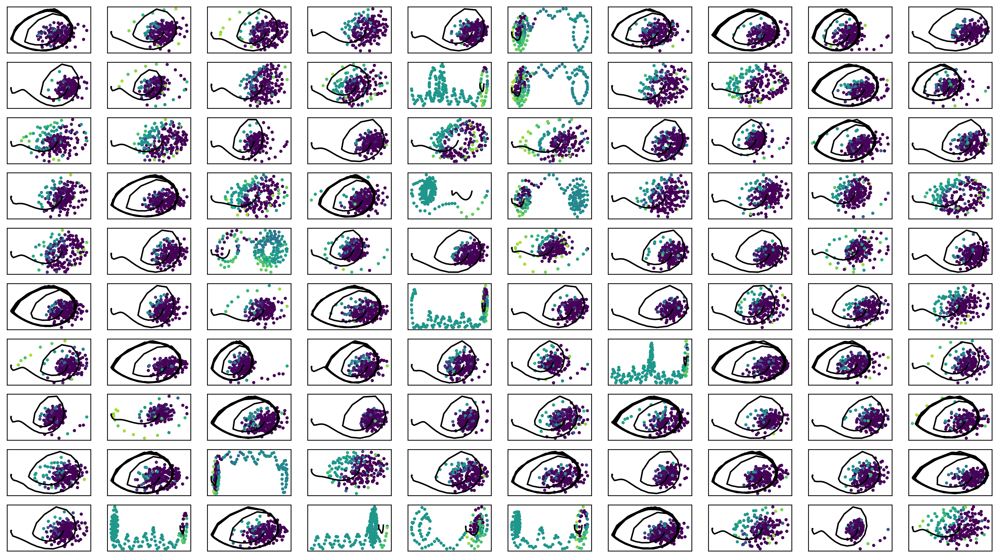

In [13]:

def f(x):
#     return x
    return np.log10(x)

fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter1.png")

In [14]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [15]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [16]:
# for i in range(100):
#     print(i, " ", end="")
#     fig = plt.figure(figsize=(16,10), dpi=150)
#     fig.patch.set_facecolor('white')
#     plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#                vmin=-8, vmax=3
#                )
#     plt.colorbar()
#     plt.savefig("ratio"+str(i)+".png")
#     plt.close()

train_weighted_vae: enc_dec
train: iter 0  trainloss -36.88277  validloss -46.68075±0.00000  bestvalidloss -46.68075  last_update 0
train: iter 1  trainloss -48.80463  validloss -39.44688±0.00000  bestvalidloss -46.68075  last_update 1
train: iter 2  trainloss -50.68853  validloss -43.17241±0.00000  bestvalidloss -46.68075  last_update 2
train: iter 3  trainloss -46.74096  validloss -41.89731±0.00000  bestvalidloss -46.68075  last_update 3
train: iter 4  trainloss -52.28647  validloss -43.77337±0.00000  bestvalidloss -46.68075  last_update 4
train: iter 5  trainloss -55.30573  validloss -44.86449±0.00000  bestvalidloss -46.68075  last_update 5
train: iter 6  trainloss -59.03144  validloss -53.51936±0.00000  bestvalidloss -53.51936  last_update 0
train: iter 7  trainloss -58.07839  validloss -53.63041±0.00000  bestvalidloss -53.63041  last_update 0
train: iter 8  trainloss -65.16970  validloss -56.09907±0.00000  bestvalidloss -56.09907  last_update 0
train: iter 9  trainloss -64.94483  

train: iter 77  trainloss -129.94009  validloss -114.34109±0.00000  bestvalidloss -118.16492  last_update 26
train: iter 78  trainloss -134.32714  validloss -110.23969±0.00000  bestvalidloss -118.16492  last_update 27
train: iter 79  trainloss -131.20490  validloss -105.64174±0.00000  bestvalidloss -118.16492  last_update 28
train: iter 80  trainloss -121.47933  validloss -107.52402±0.00000  bestvalidloss -118.16492  last_update 29
train: iter 81  trainloss -129.66667  validloss -110.79545±0.00000  bestvalidloss -118.16492  last_update 30
train: iter 82  trainloss -127.52951  validloss -114.20685±0.00000  bestvalidloss -118.16492  last_update 31
train: iter 83  trainloss -126.69699  validloss -113.76939±0.00000  bestvalidloss -118.16492  last_update 32
train: iter 84  trainloss -128.35065  validloss -103.60519±0.00000  bestvalidloss -118.16492  last_update 33
train: iter 85  trainloss -127.59467  validloss -116.63603±0.00000  bestvalidloss -118.16492  last_update 34
train: iter 86  tra

train: iter 153  trainloss -128.50659  validloss -118.33030±0.00000  bestvalidloss -121.28428  last_update 3
train: iter 154  trainloss -122.60249  validloss -112.73411±0.00000  bestvalidloss -121.28428  last_update 4
train: iter 155  trainloss -126.82750  validloss -104.99693±0.00000  bestvalidloss -121.28428  last_update 5
train: iter 156  trainloss -130.26815  validloss -86.20594±0.00000  bestvalidloss -121.28428  last_update 6
train: iter 157  trainloss -134.70379  validloss -116.24006±0.00000  bestvalidloss -121.28428  last_update 7
train: iter 158  trainloss -135.84958  validloss -121.32904±0.00000  bestvalidloss -121.32904  last_update 0
train: iter 159  trainloss -136.13079  validloss -121.87274±0.00000  bestvalidloss -121.87274  last_update 0
train: iter 160  trainloss -134.61873  validloss -116.46354±0.00000  bestvalidloss -121.87274  last_update 1
train: iter 161  trainloss -134.84867  validloss -118.03851±0.00000  bestvalidloss -121.87274  last_update 2
train: iter 162  tra

train: iter 229  trainloss -157.32891  validloss -143.66799±0.00000  bestvalidloss -151.08981  last_update 2
train: iter 230  trainloss -149.57597  validloss -136.24952±0.00000  bestvalidloss -151.08981  last_update 3
train: iter 231  trainloss -154.04262  validloss -131.13602±0.00000  bestvalidloss -151.08981  last_update 4
train: iter 232  trainloss -153.14132  validloss -144.60601±0.00000  bestvalidloss -151.08981  last_update 5
train: iter 233  trainloss -156.41864  validloss -133.07157±0.00000  bestvalidloss -151.08981  last_update 6
train: iter 234  trainloss -161.57158  validloss -148.12679±0.00000  bestvalidloss -151.08981  last_update 7
train: iter 235  trainloss -157.66590  validloss -138.32769±0.00000  bestvalidloss -151.08981  last_update 8
train: iter 236  trainloss -161.22961  validloss -140.94710±0.00000  bestvalidloss -151.08981  last_update 9
train: iter 237  trainloss -157.67433  validloss -143.54890±0.00000  bestvalidloss -151.08981  last_update 10
train: iter 238  t

train: iter 305  trainloss -178.41507  validloss -168.44696±0.00000  bestvalidloss -168.44696  last_update 0
train: iter 306  trainloss -170.39998  validloss -161.51443±0.00000  bestvalidloss -168.44696  last_update 1
train: iter 307  trainloss -172.08023  validloss -155.23142±0.00000  bestvalidloss -168.44696  last_update 2
train: iter 308  trainloss -174.24337  validloss -164.72605±0.00000  bestvalidloss -168.44696  last_update 3
train: iter 309  trainloss -174.95292  validloss -152.18875±0.00000  bestvalidloss -168.44696  last_update 4
train: iter 310  trainloss -178.86488  validloss -160.49097±0.00000  bestvalidloss -168.44696  last_update 5
train: iter 311  trainloss -181.17021  validloss -168.95750±0.00000  bestvalidloss -168.95750  last_update 0
train: iter 312  trainloss -166.44585  validloss -157.88785±0.00000  bestvalidloss -168.95750  last_update 1
train: iter 313  trainloss -159.87099  validloss -141.43273±0.00000  bestvalidloss -168.95750  last_update 2
train: iter 314  tr

train: iter 380  trainloss -181.71835  validloss -176.54014±0.00000  bestvalidloss -177.60613  last_update 3
train: iter 381  trainloss -189.00346  validloss -157.30645±0.00000  bestvalidloss -177.60613  last_update 4
train: iter 382  trainloss -194.58432  validloss -169.57758±0.00000  bestvalidloss -177.60613  last_update 5
train: iter 383  trainloss -183.45622  validloss -179.93227±0.00000  bestvalidloss -179.93227  last_update 0
train: iter 384  trainloss -192.17060  validloss -177.24970±0.00000  bestvalidloss -179.93227  last_update 1
train: iter 385  trainloss -192.11585  validloss -167.95536±0.00000  bestvalidloss -179.93227  last_update 2
train: iter 386  trainloss -180.58422  validloss -182.02902±0.00000  bestvalidloss -182.02902  last_update 0
train: iter 387  trainloss -184.26250  validloss -137.06912±0.00000  bestvalidloss -182.02902  last_update 1
train: iter 388  trainloss -192.42177  validloss -174.99539±0.00000  bestvalidloss -182.02902  last_update 2
train: iter 389  tr

train: iter 455  trainloss -205.91763  validloss -187.28230±0.00000  bestvalidloss -194.24121  last_update 13
train: iter 456  trainloss -201.54669  validloss -187.47587±0.00000  bestvalidloss -194.24121  last_update 14
train: iter 457  trainloss -200.71949  validloss -193.68112±0.00000  bestvalidloss -194.24121  last_update 15
train: iter 458  trainloss -194.98784  validloss -186.82100±0.00000  bestvalidloss -194.24121  last_update 16
train: iter 459  trainloss -203.77644  validloss -179.37406±0.00000  bestvalidloss -194.24121  last_update 17
train: iter 460  trainloss -206.90216  validloss -192.16651±0.00000  bestvalidloss -194.24121  last_update 18
train: iter 461  trainloss -207.29543  validloss -197.33092±0.00000  bestvalidloss -197.33092  last_update 0
train: iter 462  trainloss -206.16974  validloss -154.86282±0.00000  bestvalidloss -197.33092  last_update 1
train: iter 463  trainloss -203.39906  validloss -169.87112±0.00000  bestvalidloss -197.33092  last_update 2
train: iter 4

train: iter 530  trainloss -212.61655  validloss -186.52777±0.00000  bestvalidloss -203.68543  last_update 6
train: iter 531  trainloss -212.49577  validloss -189.86104±0.00000  bestvalidloss -203.68543  last_update 7
train: iter 532  trainloss -214.12016  validloss -173.60147±0.00000  bestvalidloss -203.68543  last_update 8
train: iter 533  trainloss -209.80393  validloss -192.08036±0.00000  bestvalidloss -203.68543  last_update 9
train: iter 534  trainloss -217.74715  validloss -194.12710±0.00000  bestvalidloss -203.68543  last_update 10
train: iter 535  trainloss -215.82890  validloss -201.21100±0.00000  bestvalidloss -203.68543  last_update 11
train: iter 536  trainloss -204.52686  validloss -182.23726±0.00000  bestvalidloss -203.68543  last_update 12
train: iter 537  trainloss -213.49311  validloss -197.10498±0.00000  bestvalidloss -203.68543  last_update 13
train: iter 538  trainloss -216.45118  validloss -198.25952±0.00000  bestvalidloss -203.68543  last_update 14
train: iter 53

train: iter 605  trainloss -223.73949  validloss -210.80269±0.00000  bestvalidloss -210.80269  last_update 0
train: iter 606  trainloss -222.28319  validloss -205.26459±0.00000  bestvalidloss -210.80269  last_update 1
train: iter 607  trainloss -224.71169  validloss -200.31613±0.00000  bestvalidloss -210.80269  last_update 2
train: iter 608  trainloss -221.83494  validloss -203.08279±0.00000  bestvalidloss -210.80269  last_update 3
train: iter 609  trainloss -220.41644  validloss -199.64391±0.00000  bestvalidloss -210.80269  last_update 4
train: iter 610  trainloss -227.99042  validloss -217.74936±0.00000  bestvalidloss -217.74936  last_update 0
train: iter 611  trainloss -228.22648  validloss -212.97450±0.00000  bestvalidloss -217.74936  last_update 1
train: iter 612  trainloss -209.30424  validloss -201.73226±0.00000  bestvalidloss -217.74936  last_update 2
train: iter 613  trainloss -223.28799  validloss -200.89118±0.00000  bestvalidloss -217.74936  last_update 3
train: iter 614  tr

train: iter 680  trainloss -216.47477  validloss -197.68381±0.00000  bestvalidloss -221.71545  last_update 3
train: iter 681  trainloss -224.87728  validloss -178.08842±0.00000  bestvalidloss -221.71545  last_update 4
train: iter 682  trainloss -234.19627  validloss -161.73230±0.00000  bestvalidloss -221.71545  last_update 5
train: iter 683  trainloss -222.65482  validloss -208.74776±0.00000  bestvalidloss -221.71545  last_update 6
train: iter 684  trainloss -223.20888  validloss -200.97086±0.00000  bestvalidloss -221.71545  last_update 7
train: iter 685  trainloss -225.30642  validloss -211.65116±0.00000  bestvalidloss -221.71545  last_update 8
train: iter 686  trainloss -233.33473  validloss -168.64222±0.00000  bestvalidloss -221.71545  last_update 9
train: iter 687  trainloss -231.02810  validloss -167.63625±0.00000  bestvalidloss -221.71545  last_update 10
train: iter 688  trainloss -239.39782  validloss -199.67762±0.00000  bestvalidloss -221.71545  last_update 11
train: iter 689  

train: iter 755  trainloss -242.16472  validloss -218.03935±0.00000  bestvalidloss -228.88433  last_update 35
train: iter 756  trainloss -252.58906  validloss -220.11551±0.00000  bestvalidloss -228.88433  last_update 36
train: iter 757  trainloss -247.23937  validloss -227.30163±0.00000  bestvalidloss -228.88433  last_update 37
train: iter 758  trainloss -239.07067  validloss -211.32329±0.00000  bestvalidloss -228.88433  last_update 38
train: iter 759  trainloss -242.48333  validloss -222.09589±0.00000  bestvalidloss -228.88433  last_update 39
train: iter 760  trainloss -28.43077  validloss -220.86271±0.00000  bestvalidloss -228.88433  last_update 40
train: iter 761  trainloss -208.63542  validloss -189.80350±0.00000  bestvalidloss -228.88433  last_update 41
train: iter 762  trainloss -209.11594  validloss -195.94947±0.00000  bestvalidloss -228.88433  last_update 42
train: iter 763  trainloss -220.49621  validloss -210.92531±0.00000  bestvalidloss -228.88433  last_update 43
train: iter

train: iter 830  trainloss -248.08277  validloss -223.86649±0.00000  bestvalidloss -237.07527  last_update 15
train: iter 831  trainloss -253.25792  validloss -238.51017±0.00000  bestvalidloss -238.51017  last_update 0
train: iter 832  trainloss -258.49146  validloss -222.73117±0.00000  bestvalidloss -238.51017  last_update 1
train: iter 833  trainloss -253.21068  validloss -211.91214±0.00000  bestvalidloss -238.51017  last_update 2
train: iter 834  trainloss -254.33032  validloss -231.89582±0.00000  bestvalidloss -238.51017  last_update 3
train: iter 835  trainloss -248.57395  validloss -219.37722±0.00000  bestvalidloss -238.51017  last_update 4
train: iter 836  trainloss -238.01736  validloss -214.18324±0.00000  bestvalidloss -238.51017  last_update 5
train: iter 837  trainloss -243.33508  validloss -222.38867±0.00000  bestvalidloss -238.51017  last_update 6
train: iter 838  trainloss -249.68418  validloss -216.06133±0.00000  bestvalidloss -238.51017  last_update 7
train: iter 839  t

train: iter 905  trainloss -252.49409  validloss -222.00248±0.00000  bestvalidloss -250.22765  last_update 16
train: iter 906  trainloss -235.28419  validloss -181.62048±0.00000  bestvalidloss -250.22765  last_update 17
train: iter 907  trainloss -252.37105  validloss -239.27915±0.00000  bestvalidloss -250.22765  last_update 18
train: iter 908  trainloss -265.34855  validloss -245.44743±0.00000  bestvalidloss -250.22765  last_update 19
train: iter 909  trainloss -244.11190  validloss -240.13229±0.00000  bestvalidloss -250.22765  last_update 20
train: iter 910  trainloss -266.14375  validloss -229.84289±0.00000  bestvalidloss -250.22765  last_update 21
train: iter 911  trainloss -264.55038  validloss -236.65801±0.00000  bestvalidloss -250.22765  last_update 22
train: iter 912  trainloss -264.79215  validloss -223.90475±0.00000  bestvalidloss -250.22765  last_update 23
train: iter 913  trainloss -267.14251  validloss -227.85049±0.00000  bestvalidloss -250.22765  last_update 24
train: ite

train: iter 980  trainloss -277.69504  validloss -236.54836±0.00000  bestvalidloss -260.91068  last_update 18
train: iter 981  trainloss -252.70002  validloss -220.50018±0.00000  bestvalidloss -260.91068  last_update 19
train: iter 982  trainloss -271.64100  validloss -232.60109±0.00000  bestvalidloss -260.91068  last_update 20
train: iter 983  trainloss -268.87814  validloss -252.33952±0.00000  bestvalidloss -260.91068  last_update 21
train: iter 984  trainloss -269.56562  validloss -194.13171±0.00000  bestvalidloss -260.91068  last_update 22
train: iter 985  trainloss -264.94482  validloss -247.79397±0.00000  bestvalidloss -260.91068  last_update 23
train: iter 986  trainloss -270.95252  validloss -251.42316±0.00000  bestvalidloss -260.91068  last_update 24
train: iter 987  trainloss -272.76466  validloss -252.38314±0.00000  bestvalidloss -260.91068  last_update 25
train: iter 988  trainloss -272.95705  validloss -258.79515±0.00000  bestvalidloss -260.91068  last_update 26
train: ite

train: iter 1055  trainloss -284.29080  validloss -260.72039±0.00000  bestvalidloss -266.50795  last_update 40
train: iter 1056  trainloss -283.55758  validloss -249.28704±0.00000  bestvalidloss -266.50795  last_update 41
train: iter 1057  trainloss -286.86916  validloss -240.41464±0.00000  bestvalidloss -266.50795  last_update 42
train: iter 1058  trainloss -282.48147  validloss -233.46651±0.00000  bestvalidloss -266.50795  last_update 43
train: iter 1059  trainloss -290.41137  validloss -253.97173±0.00000  bestvalidloss -266.50795  last_update 44
train: iter 1060  trainloss -275.16779  validloss -249.42660±0.00000  bestvalidloss -266.50795  last_update 45
train: iter 1061  trainloss -284.75296  validloss -223.41478±0.00000  bestvalidloss -266.50795  last_update 46
train: iter 1062  trainloss -294.02197  validloss -258.74649±0.00000  bestvalidloss -266.50795  last_update 47
train: iter 1063  trainloss -289.50352  validloss -245.44428±0.00000  bestvalidloss -266.50795  last_update 48
t

train: iter 1129  trainloss -299.16761  validloss -238.92334±0.00000  bestvalidloss -271.67877  last_update 55
train: iter 1130  trainloss -298.94015  validloss -231.39510±0.00000  bestvalidloss -271.67877  last_update 56
train: iter 1131  trainloss -294.83106  validloss -262.87337±0.00000  bestvalidloss -271.67877  last_update 57
train: iter 1132  trainloss -293.22163  validloss -254.73102±0.00000  bestvalidloss -271.67877  last_update 58
train: iter 1133  trainloss -299.77010  validloss -269.10389±0.00000  bestvalidloss -271.67877  last_update 59
train: iter 1134  trainloss -298.71823  validloss -259.50808±0.00000  bestvalidloss -271.67877  last_update 60
train: iter 1135  trainloss -285.18939  validloss -245.43096±0.00000  bestvalidloss -271.67877  last_update 61
train: iter 1136  trainloss -294.87122  validloss -270.84414±0.00000  bestvalidloss -271.67877  last_update 62
train: iter 1137  trainloss -299.82434  validloss -246.75490±0.00000  bestvalidloss -271.67877  last_update 63
t

train: iter 1203  trainloss -310.77327  validloss -256.51508±0.00000  bestvalidloss -277.54551  last_update 6
train: iter 1204  trainloss -313.18717  validloss -256.23043±0.00000  bestvalidloss -277.54551  last_update 7
train: iter 1205  trainloss -302.42725  validloss -264.23095±0.00000  bestvalidloss -277.54551  last_update 8
train: iter 1206  trainloss -299.20670  validloss -248.55815±0.00000  bestvalidloss -277.54551  last_update 9
train: iter 1207  trainloss -298.10296  validloss -205.39623±0.00000  bestvalidloss -277.54551  last_update 10
train: iter 1208  trainloss -287.56770  validloss -275.93242±0.00000  bestvalidloss -277.54551  last_update 11
train: iter 1209  trainloss -306.37185  validloss -285.94974±0.00000  bestvalidloss -285.94974  last_update 0
train: iter 1210  trainloss -309.69453  validloss -254.52921±0.00000  bestvalidloss -285.94974  last_update 1
train: iter 1211  trainloss -302.79120  validloss -266.08283±0.00000  bestvalidloss -285.94974  last_update 2
train: i

train: iter 1278  trainloss -304.27965  validloss -242.49058±0.00000  bestvalidloss -290.37342  last_update 7
train: iter 1279  trainloss -306.43850  validloss -277.42174±0.00000  bestvalidloss -290.37342  last_update 8
train: iter 1280  trainloss -310.37758  validloss -216.16256±0.00000  bestvalidloss -290.37342  last_update 9
train: iter 1281  trainloss -302.51337  validloss -233.49277±0.00000  bestvalidloss -290.37342  last_update 10
train: iter 1282  trainloss -286.92344  validloss -269.11696±0.00000  bestvalidloss -290.37342  last_update 11
train: iter 1283  trainloss -293.11727  validloss -285.88049±0.00000  bestvalidloss -290.37342  last_update 12
train: iter 1284  trainloss -307.62984  validloss -273.57659±0.00000  bestvalidloss -290.37342  last_update 13
train: iter 1285  trainloss -309.46064  validloss -271.95326±0.00000  bestvalidloss -290.37342  last_update 14
train: iter 1286  trainloss -316.47797  validloss -273.55329±0.00000  bestvalidloss -290.37342  last_update 15
trai

train: iter 1352  trainloss -316.62176  validloss -244.94676±0.00000  bestvalidloss -290.37342  last_update 81
train: iter 1353  trainloss -314.24076  validloss -253.06425±0.00000  bestvalidloss -290.37342  last_update 82
train: iter 1354  trainloss -300.88645  validloss -276.61012±0.00000  bestvalidloss -290.37342  last_update 83
train: iter 1355  trainloss -311.14825  validloss -268.01562±0.00000  bestvalidloss -290.37342  last_update 84
train: iter 1356  trainloss -303.71936  validloss -266.23759±0.00000  bestvalidloss -290.37342  last_update 85
train: iter 1357  trainloss -310.47473  validloss -241.50471±0.00000  bestvalidloss -290.37342  last_update 86
train: iter 1358  trainloss -308.05046  validloss -256.73434±0.00000  bestvalidloss -290.37342  last_update 87
train: iter 1359  trainloss -310.88114  validloss -247.19016±0.00000  bestvalidloss -290.37342  last_update 88
train: iter 1360  trainloss -310.59281  validloss -257.94367±0.00000  bestvalidloss -290.37342  last_update 89
t

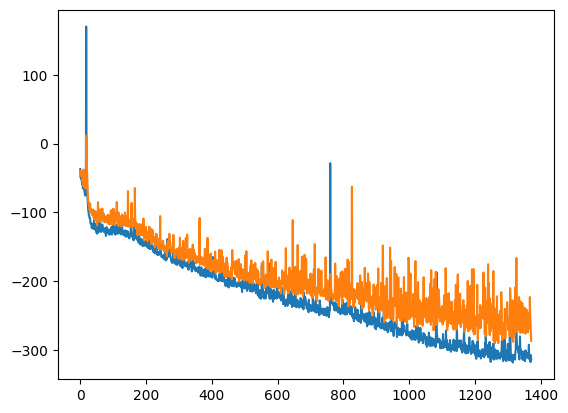

train_weighted_vae: enc
train: iter 0  trainloss -305.64169  validloss -240.07086±0.00000  bestvalidloss -240.07086  last_update 0
train: iter 1  trainloss -310.64897  validloss -271.02195±0.00000  bestvalidloss -271.02195  last_update 0
train: iter 2  trainloss -311.13262  validloss -268.92901±0.00000  bestvalidloss -271.02195  last_update 1
train: iter 3  trainloss -307.68611  validloss -221.27281±0.00000  bestvalidloss -271.02195  last_update 2
train: iter 4  trainloss -311.08778  validloss -226.26460±0.00000  bestvalidloss -271.02195  last_update 3
train: iter 5  trainloss -312.65344  validloss -220.20364±0.00000  bestvalidloss -271.02195  last_update 4
train: iter 6  trainloss -306.05049  validloss -253.46575±0.00000  bestvalidloss -271.02195  last_update 5
train: iter 7  trainloss -309.50732  validloss -269.41781±0.00000  bestvalidloss -271.02195  last_update 6
train: iter 8  trainloss -304.42413  validloss -269.91623±0.00000  bestvalidloss -271.02195  last_update 7
train: iter 9

train: iter 76  trainloss -309.78274  validloss -261.50589±0.00000  bestvalidloss -271.02195  last_update 75
train: iter 77  trainloss -313.08550  validloss -209.71538±0.00000  bestvalidloss -271.02195  last_update 76
train: iter 78  trainloss -315.18799  validloss -240.28706±0.00000  bestvalidloss -271.02195  last_update 77
train: iter 79  trainloss -313.68440  validloss -212.61186±0.00000  bestvalidloss -271.02195  last_update 78
train: iter 80  trainloss -313.65171  validloss -254.59781±0.00000  bestvalidloss -271.02195  last_update 79
train: iter 81  trainloss -314.01092  validloss -242.28185±0.00000  bestvalidloss -271.02195  last_update 80
train: iter 82  trainloss -313.63511  validloss -246.94034±0.00000  bestvalidloss -271.02195  last_update 81
train: iter 83  trainloss -313.45750  validloss -254.87125±0.00000  bestvalidloss -271.02195  last_update 82
train: iter 84  trainloss -307.19498  validloss -239.54716±0.00000  bestvalidloss -271.02195  last_update 83
train: iter 85  tra

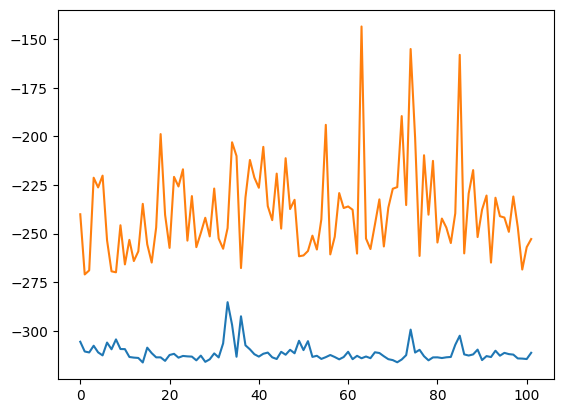

train_weighted_vae: dec
train: iter 0  trainloss -299.31350  validloss -257.81375±0.00000  bestvalidloss -257.81375  last_update 0
train: iter 1  trainloss -307.79522  validloss -228.48192±0.00000  bestvalidloss -257.81375  last_update 1
train: iter 2  trainloss -298.51651  validloss -222.04389±0.00000  bestvalidloss -257.81375  last_update 2
train: iter 3  trainloss -303.49106  validloss -240.00080±0.00000  bestvalidloss -257.81375  last_update 3
train: iter 4  trainloss -303.49639  validloss -233.46558±0.00000  bestvalidloss -257.81375  last_update 4
train: iter 5  trainloss -298.21381  validloss -218.98959±0.00000  bestvalidloss -257.81375  last_update 5
train: iter 6  trainloss -284.49203  validloss -153.30059±0.00000  bestvalidloss -257.81375  last_update 6
train: iter 7  trainloss -307.08492  validloss -234.28824±0.00000  bestvalidloss -257.81375  last_update 7
train: iter 8  trainloss -305.59150  validloss -215.64268±0.00000  bestvalidloss -257.81375  last_update 8
train: iter 9

train: iter 76  trainloss -307.49015  validloss -221.74116±0.00000  bestvalidloss -257.81375  last_update 76
train: iter 77  trainloss -303.90950  validloss -217.70684±0.00000  bestvalidloss -257.81375  last_update 77
train: iter 78  trainloss -304.82601  validloss -202.05908±0.00000  bestvalidloss -257.81375  last_update 78
train: iter 79  trainloss -287.30363  validloss -214.27182±0.00000  bestvalidloss -257.81375  last_update 79
train: iter 80  trainloss -309.59383  validloss -224.98260±0.00000  bestvalidloss -257.81375  last_update 80
train: iter 81  trainloss -299.48242  validloss -221.16098±0.00000  bestvalidloss -257.81375  last_update 81
train: iter 82  trainloss -292.07316  validloss -213.37814±0.00000  bestvalidloss -257.81375  last_update 82
train: iter 83  trainloss -303.11456  validloss -229.44805±0.00000  bestvalidloss -257.81375  last_update 83
train: iter 84  trainloss -307.17401  validloss -206.59421±0.00000  bestvalidloss -257.81375  last_update 84
train: iter 85  tra

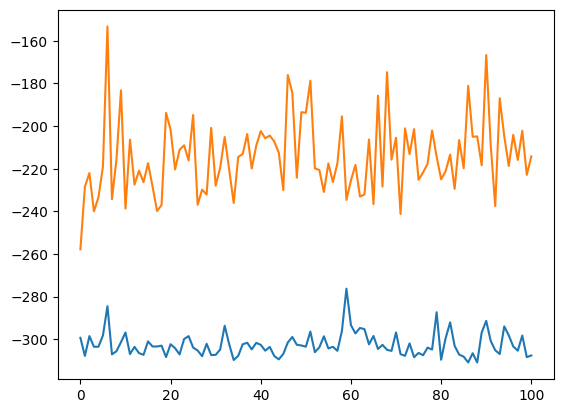

alpha 0.2 vae_lr 0.0005


In [17]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

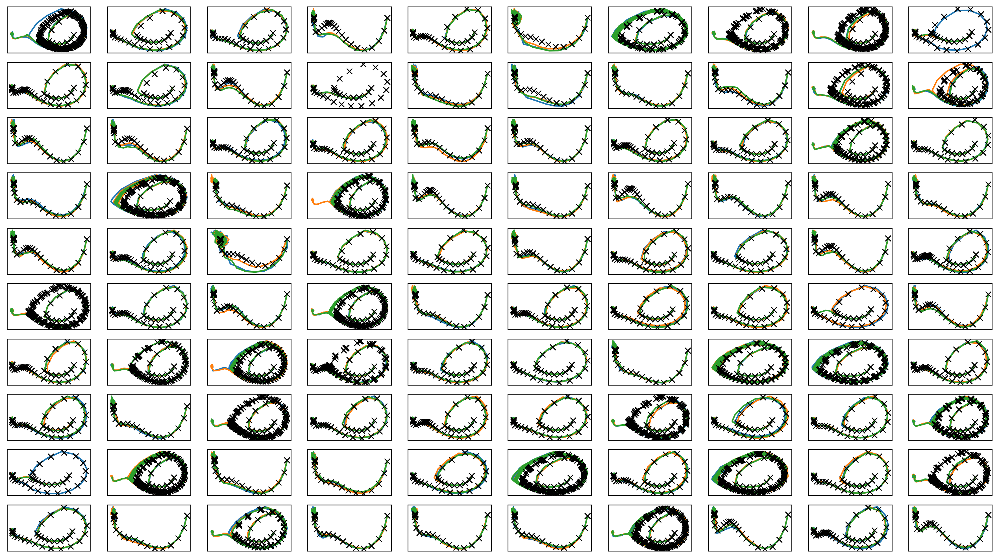

In [18]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0d = copy.deepcopy(iwvi.simenv_rolloutdata)
# iwvi.get_sim_rollout_data_fixlen()
# simdata0e = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter1.png")
plt.savefig("joint_iter1.eps")
plt.savefig("joint_iter1.pdf")
print("実環境方策rollout vs Sim環境方策rollout")

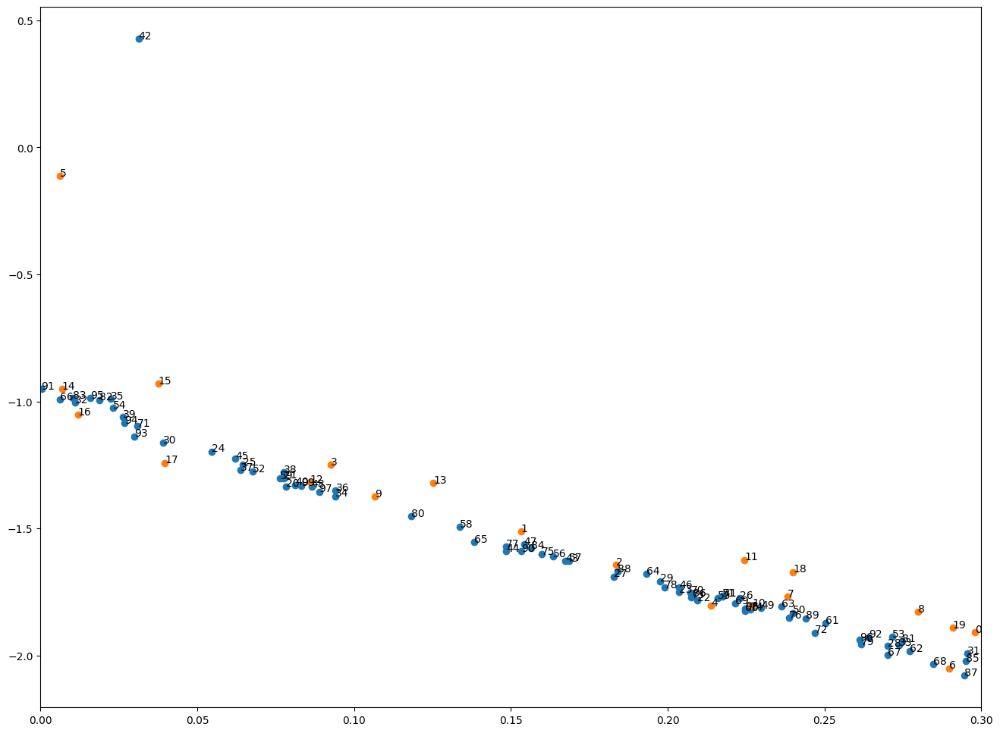

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [19]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent_iter1.png")
plt.savefig("damping_latent_iter1.eps")
plt.savefig("damping_latent_iter1.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [20]:
print(datetime.datetime.now())

2023-03-19 14:57:09.550053


# Iter2

In [21]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [22]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.41207  validloss 0.67518±0.00000  bestvalidloss 0.67518  last_update 0
train: iter 1  trainloss 0.26387  validloss 0.51173±0.00000  bestvalidloss 0.51173  last_update 0
train: iter 2  trainloss 0.21592  validloss 0.35524±0.00000  bestvalidloss 0.35524  last_update 0
train: iter 3  trainloss 0.20057  validloss 0.29423±0.00000  bestvalidloss 0.29423  last_update 0
train: iter 4  trainloss 0.19337  validloss 0.25638±0.00000  bestvalidloss 0.25638  last_update 0
train: iter 5  trainloss 0.18532  validloss 0.24517±0.00000  bestvalidloss 0.24517  last_update 0
train: iter 6  trainloss 0.17799  validloss 0.21540±0.00000  bestvalidloss 0.21540  last_update 0
train: iter 7  trainloss 0.17492  validloss 0.19805±0.00000  bestvalidloss 0.19805  last_update 0
train: iter 8  trainloss 0.17284  validloss 0.19052±0.00000  bestvalidloss 0.19052  last_update 0
train: iter 9  trainloss 0.16474  validloss 0.18354±0.00000  bestvalidloss 0.18354  last_update 0
train: iter 10  trai

train: iter 83  trainloss 0.08027  validloss 0.09606±0.00000  bestvalidloss 0.09461  last_update 3
train: iter 84  trainloss 0.07970  validloss 0.09400±0.00000  bestvalidloss 0.09400  last_update 0
train: iter 85  trainloss 0.08054  validloss 0.09376±0.00000  bestvalidloss 0.09376  last_update 0
train: iter 86  trainloss 0.08136  validloss 0.09727±0.00000  bestvalidloss 0.09376  last_update 1
train: iter 87  trainloss 0.07794  validloss 0.09382±0.00000  bestvalidloss 0.09376  last_update 2
train: iter 88  trainloss 0.07818  validloss 0.10010±0.00000  bestvalidloss 0.09376  last_update 3
train: iter 89  trainloss 0.07801  validloss 0.09562±0.00000  bestvalidloss 0.09376  last_update 4
train: iter 90  trainloss 0.07765  validloss 0.09313±0.00000  bestvalidloss 0.09313  last_update 0
train: iter 91  trainloss 0.07688  validloss 0.09376±0.00000  bestvalidloss 0.09313  last_update 1
train: iter 92  trainloss 0.07703  validloss 0.09311±0.00000  bestvalidloss 0.09311  last_update 0
train: ite

train: iter 167  trainloss 0.05911  validloss 0.07564±0.00000  bestvalidloss 0.07564  last_update 0
train: iter 168  trainloss 0.05989  validloss 0.07548±0.00000  bestvalidloss 0.07548  last_update 0
train: iter 169  trainloss 0.05964  validloss 0.07530±0.00000  bestvalidloss 0.07530  last_update 0
train: iter 170  trainloss 0.05937  validloss 0.07629±0.00000  bestvalidloss 0.07530  last_update 1
train: iter 171  trainloss 0.05888  validloss 0.07598±0.00000  bestvalidloss 0.07530  last_update 2
train: iter 172  trainloss 0.05897  validloss 0.07661±0.00000  bestvalidloss 0.07530  last_update 3
train: iter 173  trainloss 0.05854  validloss 0.07449±0.00000  bestvalidloss 0.07449  last_update 0
train: iter 174  trainloss 0.05753  validloss 0.07441±0.00000  bestvalidloss 0.07441  last_update 0
train: iter 175  trainloss 0.05779  validloss 0.07522±0.00000  bestvalidloss 0.07441  last_update 1
train: iter 176  trainloss 0.06176  validloss 0.07505±0.00000  bestvalidloss 0.07441  last_update 2


train: iter 250  trainloss 0.05250  validloss 0.07500±0.00000  bestvalidloss 0.07129  last_update 10
train: iter 251  trainloss 0.05200  validloss 0.07421±0.00000  bestvalidloss 0.07129  last_update 11
train: iter 252  trainloss 0.05132  validloss 0.07260±0.00000  bestvalidloss 0.07129  last_update 12
train: iter 253  trainloss 0.05038  validloss 0.07929±0.00000  bestvalidloss 0.07129  last_update 13
train: iter 254  trainloss 0.05067  validloss 0.07183±0.00000  bestvalidloss 0.07129  last_update 14
train: iter 255  trainloss 0.04988  validloss 0.07164±0.00000  bestvalidloss 0.07129  last_update 15
train: iter 256  trainloss 0.05091  validloss 0.07212±0.00000  bestvalidloss 0.07129  last_update 16
train: iter 257  trainloss 0.05297  validloss 0.07085±0.00000  bestvalidloss 0.07085  last_update 0
train: iter 258  trainloss 0.05133  validloss 0.07209±0.00000  bestvalidloss 0.07085  last_update 1
train: iter 259  trainloss 0.05066  validloss 0.08578±0.00000  bestvalidloss 0.07085  last_up

train: iter 334  trainloss 0.04548  validloss 0.06944±0.00000  bestvalidloss 0.06914  last_update 15
train: iter 335  trainloss 0.04540  validloss 0.06927±0.00000  bestvalidloss 0.06914  last_update 16
train: iter 336  trainloss 0.04535  validloss 0.07111±0.00000  bestvalidloss 0.06914  last_update 17
train: iter 337  trainloss 0.04742  validloss 0.07319±0.00000  bestvalidloss 0.06914  last_update 18
train: iter 338  trainloss 0.04363  validloss 0.07010±0.00000  bestvalidloss 0.06914  last_update 19
train: iter 339  trainloss 0.04674  validloss 0.06886±0.00000  bestvalidloss 0.06886  last_update 0
train: iter 340  trainloss 0.04829  validloss 0.07225±0.00000  bestvalidloss 0.06886  last_update 1
train: iter 341  trainloss 0.04404  validloss 0.07086±0.00000  bestvalidloss 0.06886  last_update 2
train: iter 342  trainloss 0.04526  validloss 0.07084±0.00000  bestvalidloss 0.06886  last_update 3
train: iter 343  trainloss 0.04454  validloss 0.07072±0.00000  bestvalidloss 0.06886  last_upda

train: iter 416  trainloss 0.04572  validloss 0.06897±0.00000  bestvalidloss 0.06748  last_update 41
train: iter 417  trainloss 0.04203  validloss 0.06847±0.00000  bestvalidloss 0.06748  last_update 42
train: iter 418  trainloss 0.04088  validloss 0.06940±0.00000  bestvalidloss 0.06748  last_update 43
train: iter 419  trainloss 0.04312  validloss 0.06822±0.00000  bestvalidloss 0.06748  last_update 44
train: iter 420  trainloss 0.04307  validloss 0.07192±0.00000  bestvalidloss 0.06748  last_update 45
train: iter 421  trainloss 0.04566  validloss 0.06897±0.00000  bestvalidloss 0.06748  last_update 46
train: iter 422  trainloss 0.04114  validloss 0.06956±0.00000  bestvalidloss 0.06748  last_update 47
train: iter 423  trainloss 0.04311  validloss 0.07016±0.00000  bestvalidloss 0.06748  last_update 48
train: iter 424  trainloss 0.04347  validloss 0.06824±0.00000  bestvalidloss 0.06748  last_update 49
train: iter 425  trainloss 0.04427  validloss 0.06765±0.00000  bestvalidloss 0.06748  last_

train: iter 498  trainloss 0.04002  validloss 0.07007±0.00000  bestvalidloss 0.06723  last_update 60
train: iter 499  trainloss 0.04052  validloss 0.06885±0.00000  bestvalidloss 0.06723  last_update 61
train: iter 500  trainloss 0.04317  validloss 0.06830±0.00000  bestvalidloss 0.06723  last_update 62
train: iter 501  trainloss 0.04625  validloss 0.07394±0.00000  bestvalidloss 0.06723  last_update 63
train: iter 502  trainloss 0.04523  validloss 0.06712±0.00000  bestvalidloss 0.06712  last_update 0
train: iter 503  trainloss 0.04247  validloss 0.06877±0.00000  bestvalidloss 0.06712  last_update 1
train: iter 504  trainloss 0.04243  validloss 0.06693±0.00000  bestvalidloss 0.06693  last_update 0
train: iter 505  trainloss 0.04047  validloss 0.07088±0.00000  bestvalidloss 0.06693  last_update 1
train: iter 506  trainloss 0.04019  validloss 0.06877±0.00000  bestvalidloss 0.06693  last_update 2
train: iter 507  trainloss 0.03950  validloss 0.07167±0.00000  bestvalidloss 0.06693  last_updat

train: iter 580  trainloss 0.03968  validloss 0.06967±0.00000  bestvalidloss 0.06693  last_update 76
train: iter 581  trainloss 0.03776  validloss 0.06752±0.00000  bestvalidloss 0.06693  last_update 77
train: iter 582  trainloss 0.03855  validloss 0.06842±0.00000  bestvalidloss 0.06693  last_update 78
train: iter 583  trainloss 0.03776  validloss 0.06853±0.00000  bestvalidloss 0.06693  last_update 79
train: iter 584  trainloss 0.04337  validloss 0.06989±0.00000  bestvalidloss 0.06693  last_update 80
train: iter 585  trainloss 0.04117  validloss 0.06832±0.00000  bestvalidloss 0.06693  last_update 81
train: iter 586  trainloss 0.05179  validloss 0.08840±0.00000  bestvalidloss 0.06693  last_update 82
train: iter 587  trainloss 0.03770  validloss 0.07471±0.00000  bestvalidloss 0.06693  last_update 83
train: iter 588  trainloss 0.03880  validloss 0.06896±0.00000  bestvalidloss 0.06693  last_update 84
train: iter 589  trainloss 0.03783  validloss 0.06782±0.00000  bestvalidloss 0.06693  last_

In [23]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -45.15811914622783
valid_loss:  -52.81682267308234
train_loss:  -35.74883928745986
valid_loss:  -25.140271000862125


1e-08 1000.0


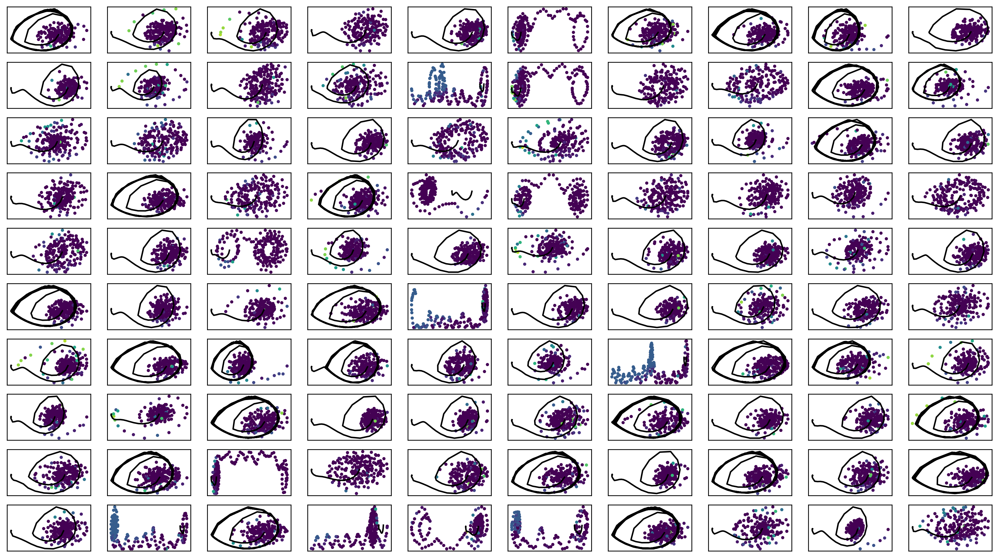

In [24]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter2.png")

In [25]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [26]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -32.21187  validloss -25.52558±0.00000  bestvalidloss -25.52558  last_update 0
train: iter 1  trainloss -32.45942  validloss -23.95136±0.00000  bestvalidloss -25.52558  last_update 1
train: iter 2  trainloss -32.91202  validloss -17.23774±0.00000  bestvalidloss -25.52558  last_update 2
train: iter 3  trainloss -31.35091  validloss -30.32590±0.00000  bestvalidloss -30.32590  last_update 0
train: iter 4  trainloss -32.29564  validloss -27.46369±0.00000  bestvalidloss -30.32590  last_update 1
train: iter 5  trainloss -32.50043  validloss -21.63335±0.00000  bestvalidloss -30.32590  last_update 2
train: iter 6  trainloss -33.01372  validloss -27.91117±0.00000  bestvalidloss -30.32590  last_update 3
train: iter 7  trainloss -32.57576  validloss -29.19165±0.00000  bestvalidloss -30.32590  last_update 4
train: iter 8  trainloss -29.99754  validloss -22.28774±0.00000  bestvalidloss -30.32590  last_update 5
train: iter 9  trainloss -30.65996  

train: iter 78  trainloss -30.50435  validloss -28.58587±0.00000  bestvalidloss -35.03763  last_update 34
train: iter 79  trainloss -30.43992  validloss -28.33065±0.00000  bestvalidloss -35.03763  last_update 35
train: iter 80  trainloss -31.20023  validloss -29.07022±0.00000  bestvalidloss -35.03763  last_update 36
train: iter 81  trainloss -28.13395  validloss -30.65949±0.00000  bestvalidloss -35.03763  last_update 37
train: iter 82  trainloss -30.75245  validloss -28.73868±0.00000  bestvalidloss -35.03763  last_update 38
train: iter 83  trainloss -30.40058  validloss -31.15985±0.00000  bestvalidloss -35.03763  last_update 39
train: iter 84  trainloss -24.96208  validloss -18.63707±0.00000  bestvalidloss -35.03763  last_update 40
train: iter 85  trainloss -28.44857  validloss -25.51860±0.00000  bestvalidloss -35.03763  last_update 41
train: iter 86  trainloss -27.09345  validloss -22.87610±0.00000  bestvalidloss -35.03763  last_update 42
train: iter 87  trainloss -29.38138  validloss

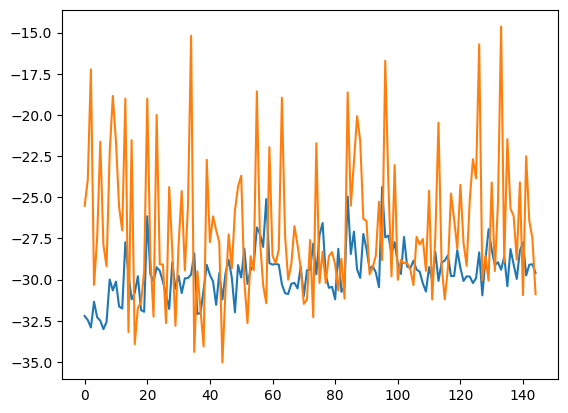

train_weighted_vae: enc
train: iter 0  trainloss -29.34121  validloss -27.72211±0.00000  bestvalidloss -27.72211  last_update 0
train: iter 1  trainloss -28.04398  validloss -24.54501±0.00000  bestvalidloss -27.72211  last_update 1
train: iter 2  trainloss -28.80944  validloss -29.66952±0.00000  bestvalidloss -29.66952  last_update 0
train: iter 3  trainloss -28.88886  validloss -28.20898±0.00000  bestvalidloss -29.66952  last_update 1
train: iter 4  trainloss -29.46947  validloss -23.18968±0.00000  bestvalidloss -29.66952  last_update 2
train: iter 5  trainloss -29.06507  validloss -26.60896±0.00000  bestvalidloss -29.66952  last_update 3
train: iter 6  trainloss -30.44331  validloss -23.31702±0.00000  bestvalidloss -29.66952  last_update 4
train: iter 7  trainloss -29.79219  validloss -26.70350±0.00000  bestvalidloss -29.66952  last_update 5
train: iter 8  trainloss -28.19377  validloss -27.04384±0.00000  bestvalidloss -29.66952  last_update 6
train: iter 9  trainloss -29.90625  vali

train: iter 78  trainloss -29.80478  validloss -26.08933±0.00000  bestvalidloss -33.57802  last_update 41
train: iter 79  trainloss -29.20898  validloss -28.49754±0.00000  bestvalidloss -33.57802  last_update 42
train: iter 80  trainloss -30.51053  validloss -29.32186±0.00000  bestvalidloss -33.57802  last_update 43
train: iter 81  trainloss -29.29470  validloss -34.19077±0.00000  bestvalidloss -34.19077  last_update 0
train: iter 82  trainloss -29.94271  validloss -29.96955±0.00000  bestvalidloss -34.19077  last_update 1
train: iter 83  trainloss -29.61077  validloss -26.42870±0.00000  bestvalidloss -34.19077  last_update 2
train: iter 84  trainloss -30.50987  validloss -20.78781±0.00000  bestvalidloss -34.19077  last_update 3
train: iter 85  trainloss -28.77470  validloss -25.03964±0.00000  bestvalidloss -34.19077  last_update 4
train: iter 86  trainloss -30.10049  validloss -24.22123±0.00000  bestvalidloss -34.19077  last_update 5
train: iter 87  trainloss -29.66865  validloss -29.4

train: iter 155  trainloss -30.58990  validloss -31.16068±0.00000  bestvalidloss -35.51130  last_update 20
train: iter 156  trainloss -27.57412  validloss -28.80268±0.00000  bestvalidloss -35.51130  last_update 21
train: iter 157  trainloss -29.12010  validloss -30.65006±0.00000  bestvalidloss -35.51130  last_update 22
train: iter 158  trainloss -29.60131  validloss -25.91354±0.00000  bestvalidloss -35.51130  last_update 23
train: iter 159  trainloss -30.83684  validloss -27.11685±0.00000  bestvalidloss -35.51130  last_update 24
train: iter 160  trainloss -29.55309  validloss -26.93584±0.00000  bestvalidloss -35.51130  last_update 25
train: iter 161  trainloss -30.53231  validloss -30.60351±0.00000  bestvalidloss -35.51130  last_update 26
train: iter 162  trainloss -30.53117  validloss -26.60378±0.00000  bestvalidloss -35.51130  last_update 27
train: iter 163  trainloss -30.37262  validloss -28.62009±0.00000  bestvalidloss -35.51130  last_update 28
train: iter 164  trainloss -29.83266 

train: iter 232  trainloss -31.30300  validloss -26.89287±0.00000  bestvalidloss -35.51130  last_update 97
train: iter 233  trainloss -30.09967  validloss -27.83792±0.00000  bestvalidloss -35.51130  last_update 98
train: iter 234  trainloss -30.09965  validloss -31.42014±0.00000  bestvalidloss -35.51130  last_update 99
train: iter 235  trainloss -30.32038  validloss -29.63737±0.00000  bestvalidloss -35.51130  last_update 100
train: fin


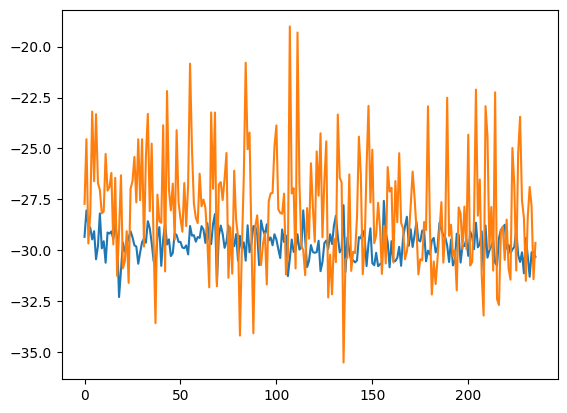

train_weighted_vae: dec
train: iter 0  trainloss -30.24137  validloss -29.69001±0.00000  bestvalidloss -29.69001  last_update 0
train: iter 1  trainloss -29.07858  validloss -23.81700±0.00000  bestvalidloss -29.69001  last_update 1
train: iter 2  trainloss -30.68715  validloss -31.41875±0.00000  bestvalidloss -31.41875  last_update 0
train: iter 3  trainloss -31.15294  validloss -30.44656±0.00000  bestvalidloss -31.41875  last_update 1
train: iter 4  trainloss -29.19098  validloss -26.72820±0.00000  bestvalidloss -31.41875  last_update 2
train: iter 5  trainloss -30.03525  validloss -24.42717±0.00000  bestvalidloss -31.41875  last_update 3
train: iter 6  trainloss -30.66389  validloss -28.60336±0.00000  bestvalidloss -31.41875  last_update 4
train: iter 7  trainloss -30.02698  validloss -30.34496±0.00000  bestvalidloss -31.41875  last_update 5
train: iter 8  trainloss -29.75416  validloss -23.11967±0.00000  bestvalidloss -31.41875  last_update 6
train: iter 9  trainloss -30.23340  vali

train: iter 78  trainloss -31.13660  validloss -26.26016±0.00000  bestvalidloss -35.97857  last_update 12
train: iter 79  trainloss -30.46687  validloss -27.73533±0.00000  bestvalidloss -35.97857  last_update 13
train: iter 80  trainloss -30.93733  validloss -27.03946±0.00000  bestvalidloss -35.97857  last_update 14
train: iter 81  trainloss -29.70912  validloss -26.97860±0.00000  bestvalidloss -35.97857  last_update 15
train: iter 82  trainloss -29.21447  validloss -26.19055±0.00000  bestvalidloss -35.97857  last_update 16
train: iter 83  trainloss -30.43791  validloss -24.80447±0.00000  bestvalidloss -35.97857  last_update 17
train: iter 84  trainloss -28.90067  validloss -27.18680±0.00000  bestvalidloss -35.97857  last_update 18
train: iter 85  trainloss -29.88353  validloss -29.90673±0.00000  bestvalidloss -35.97857  last_update 19
train: iter 86  trainloss -27.22208  validloss -25.55761±0.00000  bestvalidloss -35.97857  last_update 20
train: iter 87  trainloss -28.31357  validloss

train: iter 155  trainloss -29.65750  validloss -27.25151±0.00000  bestvalidloss -35.97857  last_update 89
train: iter 156  trainloss -31.05858  validloss -33.20761±0.00000  bestvalidloss -35.97857  last_update 90
train: iter 157  trainloss -30.99723  validloss -34.34027±0.00000  bestvalidloss -35.97857  last_update 91
train: iter 158  trainloss -30.11863  validloss -28.91256±0.00000  bestvalidloss -35.97857  last_update 92
train: iter 159  trainloss -28.80550  validloss -28.07037±0.00000  bestvalidloss -35.97857  last_update 93
train: iter 160  trainloss -30.37982  validloss -28.24167±0.00000  bestvalidloss -35.97857  last_update 94
train: iter 161  trainloss -32.13944  validloss -26.19710±0.00000  bestvalidloss -35.97857  last_update 95
train: iter 162  trainloss -30.68142  validloss -27.75011±0.00000  bestvalidloss -35.97857  last_update 96
train: iter 163  trainloss -30.03180  validloss -30.17941±0.00000  bestvalidloss -35.97857  last_update 97
train: iter 164  trainloss -28.39977 

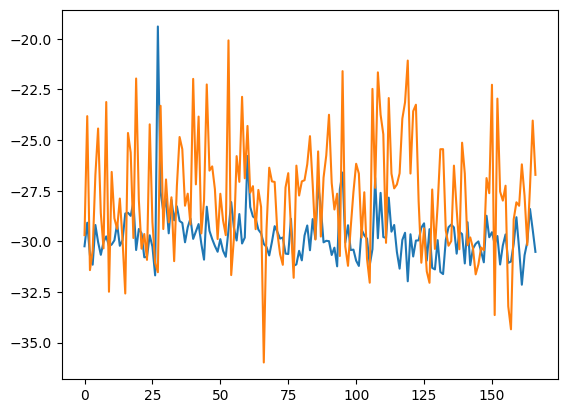

alpha 0.2 vae_lr 0.0005


In [27]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

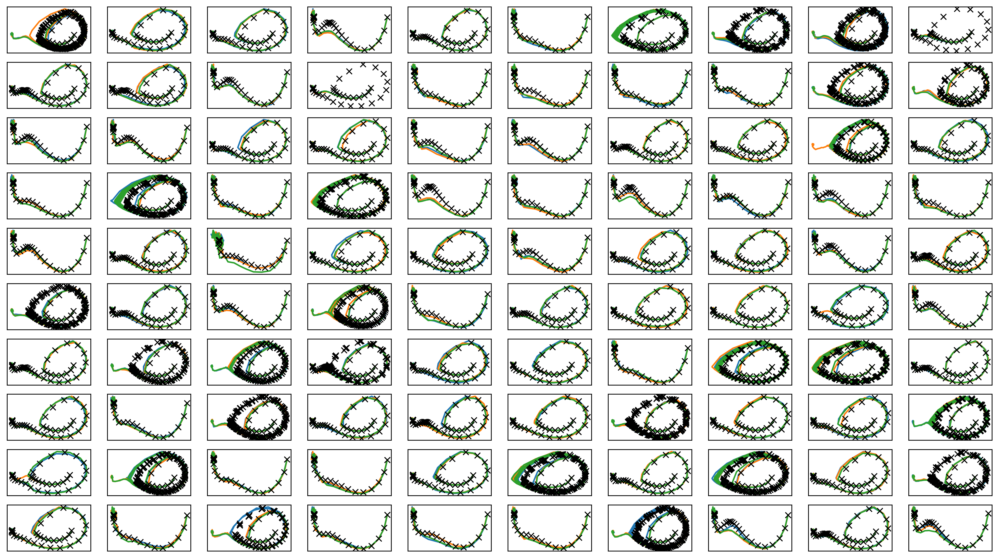

In [28]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter2.png")
plt.savefig("joint_iter2.eps")
plt.savefig("joint_iter2.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

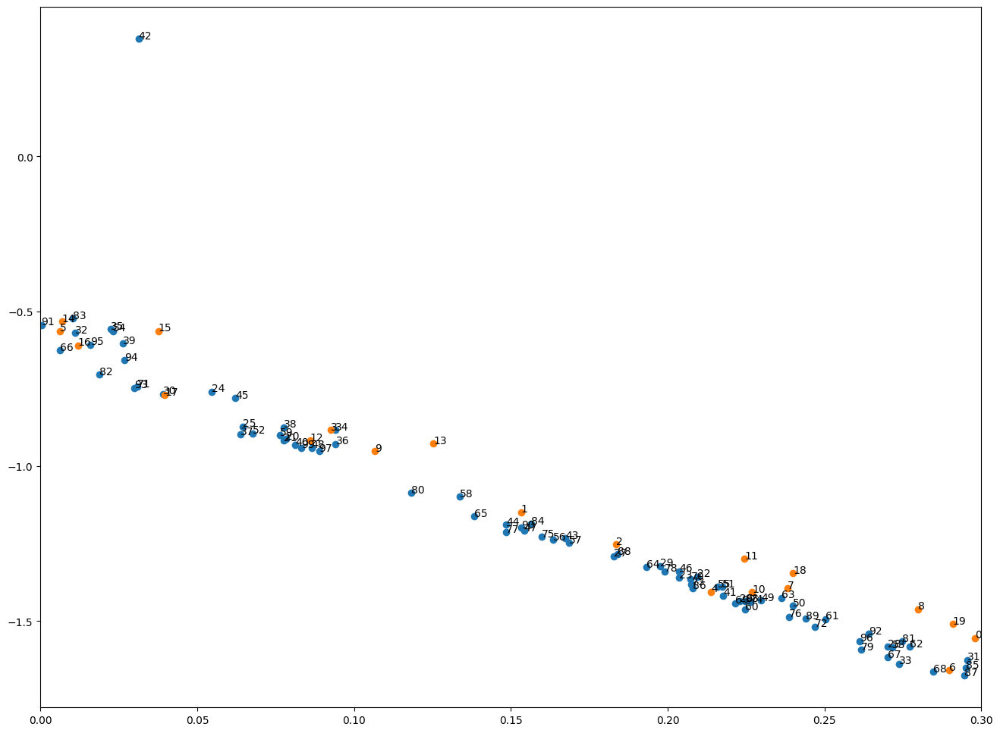

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [29]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent_iter2.png")
plt.savefig("damping_latent_iter2.eps")
plt.savefig("damping_latent_iter2.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [30]:
print(datetime.datetime.now())

2023-03-19 15:02:41.159620


# Iter 3

In [31]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [32]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)



train: iter 0  trainloss 0.09166  validloss 0.23717±0.00000  bestvalidloss 0.23717  last_update 0
train: iter 1  trainloss 0.04863  validloss 0.06825±0.00000  bestvalidloss 0.06825  last_update 0
train: iter 2  trainloss 0.04623  validloss 0.06487±0.00000  bestvalidloss 0.06487  last_update 0
train: iter 3  trainloss 0.04398  validloss 0.06008±0.00000  bestvalidloss 0.06008  last_update 0
train: iter 4  trainloss 0.04448  validloss 0.06348±0.00000  bestvalidloss 0.06008  last_update 1
train: iter 5  trainloss 0.04069  validloss 0.05624±0.00000  bestvalidloss 0.05624  last_update 0
train: iter 6  trainloss 0.04042  validloss 0.05608±0.00000  bestvalidloss 0.05608  last_update 0
train: iter 7  trainloss 0.04151  validloss 0.05547±0.00000  bestvalidloss 0.05547  last_update 0
train: iter 8  trainloss 0.04077  validloss 0.05469±0.00000  bestvalidloss 0.05469  last_update 0
train: iter 9  trainloss 0.04197  validloss 0.05796±0.00000  bestvalidloss 0.05469  last_update 1
train: iter 10  trai

train: iter 83  trainloss 0.03658  validloss 0.04983±0.00000  bestvalidloss 0.04916  last_update 6
train: iter 84  trainloss 0.03640  validloss 0.04892±0.00000  bestvalidloss 0.04892  last_update 0
train: iter 85  trainloss 0.04011  validloss 0.05286±0.00000  bestvalidloss 0.04892  last_update 1
train: iter 86  trainloss 0.04412  validloss 0.05031±0.00000  bestvalidloss 0.04892  last_update 2
train: iter 87  trainloss 0.04606  validloss 0.08251±0.00000  bestvalidloss 0.04892  last_update 3
train: iter 88  trainloss 0.03598  validloss 0.05009±0.00000  bestvalidloss 0.04892  last_update 4
train: iter 89  trainloss 0.03588  validloss 0.05204±0.00000  bestvalidloss 0.04892  last_update 5
train: iter 90  trainloss 0.03701  validloss 0.04954±0.00000  bestvalidloss 0.04892  last_update 6
train: iter 91  trainloss 0.05014  validloss 0.07210±0.00000  bestvalidloss 0.04892  last_update 7
train: iter 92  trainloss 0.03700  validloss 0.05031±0.00000  bestvalidloss 0.04892  last_update 8
train: ite

train: iter 165  trainloss 0.03546  validloss 0.05140±0.00000  bestvalidloss 0.04749  last_update 5
train: iter 166  trainloss 0.03936  validloss 0.05205±0.00000  bestvalidloss 0.04749  last_update 6
train: iter 167  trainloss 0.03850  validloss 0.05661±0.00000  bestvalidloss 0.04749  last_update 7
train: iter 168  trainloss 0.03460  validloss 0.04837±0.00000  bestvalidloss 0.04749  last_update 8
train: iter 169  trainloss 0.03592  validloss 0.04827±0.00000  bestvalidloss 0.04749  last_update 9
train: iter 170  trainloss 0.03747  validloss 0.05134±0.00000  bestvalidloss 0.04749  last_update 10
train: iter 171  trainloss 0.05370  validloss 0.05303±0.00000  bestvalidloss 0.04749  last_update 11
train: iter 172  trainloss 0.04210  validloss 0.05215±0.00000  bestvalidloss 0.04749  last_update 12
train: iter 173  trainloss 0.03702  validloss 0.04819±0.00000  bestvalidloss 0.04749  last_update 13
train: iter 174  trainloss 0.03438  validloss 0.05310±0.00000  bestvalidloss 0.04749  last_updat

train: iter 247  trainloss 0.03632  validloss 0.05271±0.00000  bestvalidloss 0.04691  last_update 11
train: iter 248  trainloss 0.03349  validloss 0.05120±0.00000  bestvalidloss 0.04691  last_update 12
train: iter 249  trainloss 0.03345  validloss 0.04786±0.00000  bestvalidloss 0.04691  last_update 13
train: iter 250  trainloss 0.03331  validloss 0.04654±0.00000  bestvalidloss 0.04654  last_update 0
train: iter 251  trainloss 0.03427  validloss 0.05006±0.00000  bestvalidloss 0.04654  last_update 1
train: iter 252  trainloss 0.03479  validloss 0.04965±0.00000  bestvalidloss 0.04654  last_update 2
train: iter 253  trainloss 0.03297  validloss 0.04739±0.00000  bestvalidloss 0.04654  last_update 3
train: iter 254  trainloss 0.03576  validloss 0.05322±0.00000  bestvalidloss 0.04654  last_update 4
train: iter 255  trainloss 0.03498  validloss 0.04928±0.00000  bestvalidloss 0.04654  last_update 5
train: iter 256  trainloss 0.03293  validloss 0.04679±0.00000  bestvalidloss 0.04654  last_update

train: iter 329  trainloss 0.03398  validloss 0.05790±0.00000  bestvalidloss 0.04619  last_update 6
train: iter 330  trainloss 0.03353  validloss 0.04693±0.00000  bestvalidloss 0.04619  last_update 7
train: iter 331  trainloss 0.03508  validloss 0.05159±0.00000  bestvalidloss 0.04619  last_update 8
train: iter 332  trainloss 0.03282  validloss 0.05196±0.00000  bestvalidloss 0.04619  last_update 9
train: iter 333  trainloss 0.03290  validloss 0.04766±0.00000  bestvalidloss 0.04619  last_update 10
train: iter 334  trainloss 0.03527  validloss 0.04858±0.00000  bestvalidloss 0.04619  last_update 11
train: iter 335  trainloss 0.03306  validloss 0.04989±0.00000  bestvalidloss 0.04619  last_update 12
train: iter 336  trainloss 0.03268  validloss 0.04763±0.00000  bestvalidloss 0.04619  last_update 13
train: iter 337  trainloss 0.03398  validloss 0.04812±0.00000  bestvalidloss 0.04619  last_update 14
train: iter 338  trainloss 0.03284  validloss 0.04618±0.00000  bestvalidloss 0.04618  last_upda

train: iter 411  trainloss 0.04208  validloss 0.07161±0.00000  bestvalidloss 0.04518  last_update 1
train: iter 412  trainloss 0.04171  validloss 0.07349±0.00000  bestvalidloss 0.04518  last_update 2
train: iter 413  trainloss 0.03399  validloss 0.05476±0.00000  bestvalidloss 0.04518  last_update 3
train: iter 414  trainloss 0.03437  validloss 0.04874±0.00000  bestvalidloss 0.04518  last_update 4
train: iter 415  trainloss 0.03155  validloss 0.04703±0.00000  bestvalidloss 0.04518  last_update 5
train: iter 416  trainloss 0.03283  validloss 0.04589±0.00000  bestvalidloss 0.04518  last_update 6
train: iter 417  trainloss 0.03134  validloss 0.04656±0.00000  bestvalidloss 0.04518  last_update 7
train: iter 418  trainloss 0.03317  validloss 0.04795±0.00000  bestvalidloss 0.04518  last_update 8
train: iter 419  trainloss 0.03201  validloss 0.04667±0.00000  bestvalidloss 0.04518  last_update 9
train: iter 420  trainloss 0.03478  validloss 0.04563±0.00000  bestvalidloss 0.04518  last_update 10

train: iter 495  trainloss 0.03674  validloss 0.06603±0.00000  bestvalidloss 0.04514  last_update 14
train: iter 496  trainloss 0.03092  validloss 0.04611±0.00000  bestvalidloss 0.04514  last_update 15
train: iter 497  trainloss 0.03312  validloss 0.04843±0.00000  bestvalidloss 0.04514  last_update 16
train: iter 498  trainloss 0.03126  validloss 0.05292±0.00000  bestvalidloss 0.04514  last_update 17
train: iter 499  trainloss 0.04022  validloss 0.06226±0.00000  bestvalidloss 0.04514  last_update 18
train: iter 500  trainloss 0.03515  validloss 0.04892±0.00000  bestvalidloss 0.04514  last_update 19
train: iter 501  trainloss 0.05458  validloss 0.04755±0.00000  bestvalidloss 0.04514  last_update 20
train: iter 502  trainloss 0.03547  validloss 0.04954±0.00000  bestvalidloss 0.04514  last_update 21
train: iter 503  trainloss 0.03064  validloss 0.04866±0.00000  bestvalidloss 0.04514  last_update 22
train: iter 504  trainloss 0.03044  validloss 0.04530±0.00000  bestvalidloss 0.04514  last_

train: iter 577  trainloss 0.03051  validloss 0.04649±0.00000  bestvalidloss 0.04481  last_update 38
train: iter 578  trainloss 0.03331  validloss 0.04783±0.00000  bestvalidloss 0.04481  last_update 39
train: iter 579  trainloss 0.03188  validloss 0.04508±0.00000  bestvalidloss 0.04481  last_update 40
train: iter 580  trainloss 0.04030  validloss 0.04672±0.00000  bestvalidloss 0.04481  last_update 41
train: iter 581  trainloss 0.03782  validloss 0.04894±0.00000  bestvalidloss 0.04481  last_update 42
train: iter 582  trainloss 0.03038  validloss 0.05093±0.00000  bestvalidloss 0.04481  last_update 43
train: iter 583  trainloss 0.03357  validloss 0.04609±0.00000  bestvalidloss 0.04481  last_update 44
train: iter 584  trainloss 0.03166  validloss 0.04963±0.00000  bestvalidloss 0.04481  last_update 45
train: iter 585  trainloss 0.03113  validloss 0.04583±0.00000  bestvalidloss 0.04481  last_update 46
train: iter 586  trainloss 0.03196  validloss 0.04751±0.00000  bestvalidloss 0.04481  last_

In [33]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -91.0429094810784
valid_loss:  -109.84225067615509
train_loss:  -37.13184873953462
valid_loss:  -29.766411386728286


1e-08 1000.0


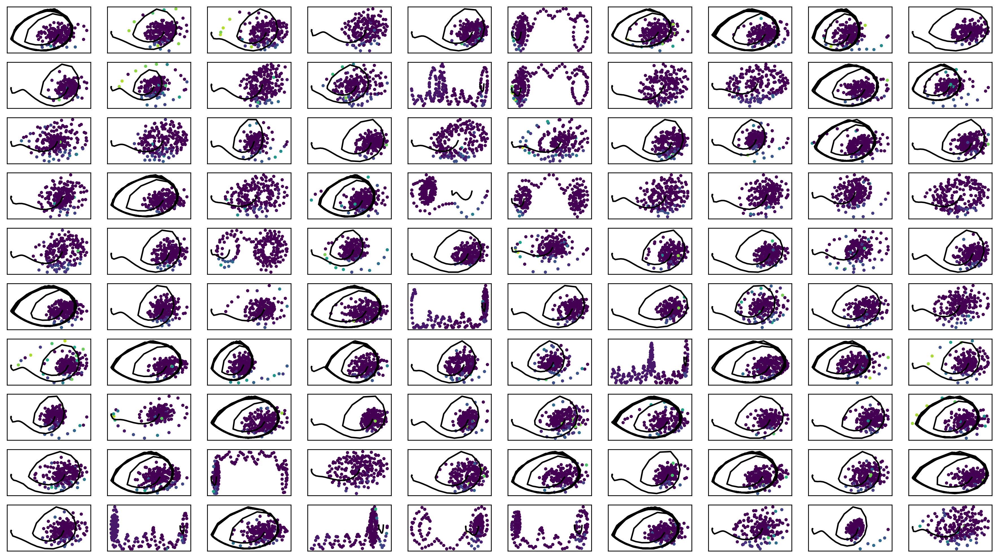

In [34]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter3.png")

In [35]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [36]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [37]:
# i = 49
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -35.62757  validloss -32.77839±0.00000  bestvalidloss -32.77839  last_update 0
train: iter 1  trainloss -34.86762  validloss -40.60383±0.00000  bestvalidloss -40.60383  last_update 0
train: iter 2  trainloss -37.97612  validloss -39.70068±0.00000  bestvalidloss -40.60383  last_update 1
train: iter 3  trainloss -37.07758  validloss -29.43330±0.00000  bestvalidloss -40.60383  last_update 2
train: iter 4  trainloss -37.55478  validloss -34.55937±0.00000  bestvalidloss -40.60383  last_update 3
train: iter 5  trainloss -37.07149  validloss -40.01125±0.00000  bestvalidloss -40.60383  last_update 4
train: iter 6  trainloss -36.90980  validloss -33.06153±0.00000  bestvalidloss -40.60383  last_update 5
train: iter 7  trainloss -36.00673  validloss -28.11661±0.00000  bestvalidloss -40.60383  last_update 6
train: iter 8  trainloss -38.10886  validloss -41.48263±0.00000  bestvalidloss -41.48263  last_update 0
train: iter 9  trainloss -34.68571  

train: iter 78  trainloss -34.65955  validloss -26.13933±0.00000  bestvalidloss -44.84852  last_update 44
train: iter 79  trainloss -34.53939  validloss -36.71967±0.00000  bestvalidloss -44.84852  last_update 45
train: iter 80  trainloss -32.11159  validloss -36.87635±0.00000  bestvalidloss -44.84852  last_update 46
train: iter 81  trainloss -35.22451  validloss -33.64292±0.00000  bestvalidloss -44.84852  last_update 47
train: iter 82  trainloss -34.65205  validloss -32.90476±0.00000  bestvalidloss -44.84852  last_update 48
train: iter 83  trainloss -34.78940  validloss -30.35208±0.00000  bestvalidloss -44.84852  last_update 49
train: iter 84  trainloss -33.69562  validloss -36.85726±0.00000  bestvalidloss -44.84852  last_update 50
train: iter 85  trainloss -35.44569  validloss -25.55641±0.00000  bestvalidloss -44.84852  last_update 51
train: iter 86  trainloss -36.50487  validloss -37.75508±0.00000  bestvalidloss -44.84852  last_update 52
train: iter 87  trainloss -35.87809  validloss

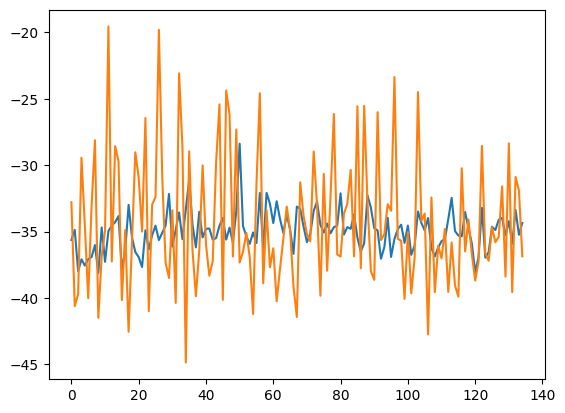

train_weighted_vae: enc
train: iter 0  trainloss -34.04526  validloss -34.79414±0.00000  bestvalidloss -34.79414  last_update 0
train: iter 1  trainloss -33.55559  validloss -35.70519±0.00000  bestvalidloss -35.70519  last_update 0
train: iter 2  trainloss -33.23297  validloss -32.09425±0.00000  bestvalidloss -35.70519  last_update 1
train: iter 3  trainloss -32.94442  validloss -37.92460±0.00000  bestvalidloss -37.92460  last_update 0
train: iter 4  trainloss -36.15581  validloss -34.93268±0.00000  bestvalidloss -37.92460  last_update 1
train: iter 5  trainloss -34.86535  validloss -39.10495±0.00000  bestvalidloss -39.10495  last_update 0
train: iter 6  trainloss -37.28562  validloss -35.16866±0.00000  bestvalidloss -39.10495  last_update 1
train: iter 7  trainloss -34.41799  validloss -41.12969±0.00000  bestvalidloss -41.12969  last_update 0
train: iter 8  trainloss -33.10204  validloss -41.70201±0.00000  bestvalidloss -41.70201  last_update 0
train: iter 9  trainloss -34.90652  vali

train: iter 79  trainloss -35.05285  validloss -38.32226±0.00000  bestvalidloss -43.75148  last_update 64
train: iter 80  trainloss -36.63275  validloss -36.98625±0.00000  bestvalidloss -43.75148  last_update 65
train: iter 81  trainloss -35.56450  validloss -33.80425±0.00000  bestvalidloss -43.75148  last_update 66
train: iter 82  trainloss -34.45635  validloss -36.59881±0.00000  bestvalidloss -43.75148  last_update 67
train: iter 83  trainloss -33.66173  validloss -28.98643±0.00000  bestvalidloss -43.75148  last_update 68
train: iter 84  trainloss -35.02313  validloss -37.31522±0.00000  bestvalidloss -43.75148  last_update 69
train: iter 85  trainloss -35.06525  validloss -35.92593±0.00000  bestvalidloss -43.75148  last_update 70
train: iter 86  trainloss -34.65853  validloss -35.55428±0.00000  bestvalidloss -43.75148  last_update 71
train: iter 87  trainloss -35.34042  validloss -40.23483±0.00000  bestvalidloss -43.75148  last_update 72
train: iter 88  trainloss -35.88738  validloss

train: iter 156  trainloss -36.71189  validloss -37.38308±0.00000  bestvalidloss -44.82312  last_update 59
train: iter 157  trainloss -33.97902  validloss -27.85008±0.00000  bestvalidloss -44.82312  last_update 60
train: iter 158  trainloss -36.85844  validloss -37.91789±0.00000  bestvalidloss -44.82312  last_update 61
train: iter 159  trainloss -37.11990  validloss -36.40215±0.00000  bestvalidloss -44.82312  last_update 62
train: iter 160  trainloss -36.96595  validloss -35.69217±0.00000  bestvalidloss -44.82312  last_update 63
train: iter 161  trainloss -33.34372  validloss -35.67822±0.00000  bestvalidloss -44.82312  last_update 64
train: iter 162  trainloss -37.25851  validloss -36.92303±0.00000  bestvalidloss -44.82312  last_update 65
train: iter 163  trainloss -34.23289  validloss -36.88569±0.00000  bestvalidloss -44.82312  last_update 66
train: iter 164  trainloss -34.18649  validloss -27.32615±0.00000  bestvalidloss -44.82312  last_update 67
train: iter 165  trainloss -36.33060 

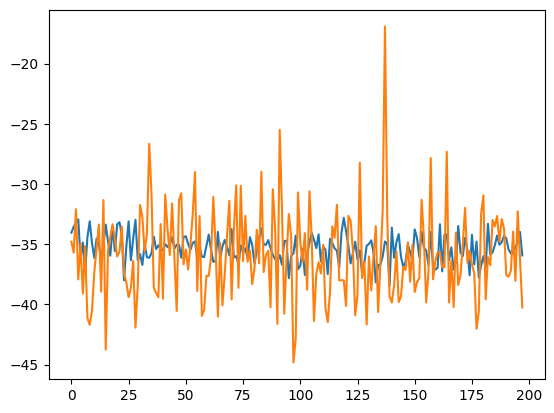

train_weighted_vae: dec
train: iter 0  trainloss -33.95566  validloss -38.16465±0.00000  bestvalidloss -38.16465  last_update 0
train: iter 1  trainloss -36.55937  validloss -35.87022±0.00000  bestvalidloss -38.16465  last_update 1
train: iter 2  trainloss -35.77664  validloss -31.33171±0.00000  bestvalidloss -38.16465  last_update 2
train: iter 3  trainloss -36.78926  validloss -32.71461±0.00000  bestvalidloss -38.16465  last_update 3
train: iter 4  trainloss -37.24882  validloss -30.06004±0.00000  bestvalidloss -38.16465  last_update 4
train: iter 5  trainloss -36.09988  validloss -38.89845±0.00000  bestvalidloss -38.89845  last_update 0
train: iter 6  trainloss -34.19738  validloss -35.87309±0.00000  bestvalidloss -38.89845  last_update 1
train: iter 7  trainloss -34.89529  validloss -34.28007±0.00000  bestvalidloss -38.89845  last_update 2
train: iter 8  trainloss -31.25725  validloss -15.40885±0.00000  bestvalidloss -38.89845  last_update 3
train: iter 9  trainloss -34.17414  vali

train: iter 78  trainloss -36.42204  validloss -36.54746±0.00000  bestvalidloss -43.51301  last_update 35
train: iter 79  trainloss -33.99040  validloss -41.11211±0.00000  bestvalidloss -43.51301  last_update 36
train: iter 80  trainloss -35.48932  validloss -35.78449±0.00000  bestvalidloss -43.51301  last_update 37
train: iter 81  trainloss -37.10146  validloss -40.88805±0.00000  bestvalidloss -43.51301  last_update 38
train: iter 82  trainloss -35.91859  validloss -26.65386±0.00000  bestvalidloss -43.51301  last_update 39
train: iter 83  trainloss -37.74960  validloss -37.27673±0.00000  bestvalidloss -43.51301  last_update 40
train: iter 84  trainloss -37.26171  validloss -36.02776±0.00000  bestvalidloss -43.51301  last_update 41
train: iter 85  trainloss -36.20439  validloss -42.63188±0.00000  bestvalidloss -43.51301  last_update 42
train: iter 86  trainloss -33.16391  validloss -39.62589±0.00000  bestvalidloss -43.51301  last_update 43
train: iter 87  trainloss -33.40666  validloss

train: iter 155  trainloss -37.05851  validloss -36.11253±0.00000  bestvalidloss -43.77533  last_update 14
train: iter 156  trainloss -35.49996  validloss -38.20270±0.00000  bestvalidloss -43.77533  last_update 15
train: iter 157  trainloss -36.98124  validloss -38.64484±0.00000  bestvalidloss -43.77533  last_update 16
train: iter 158  trainloss -35.27141  validloss -29.95621±0.00000  bestvalidloss -43.77533  last_update 17
train: iter 159  trainloss -37.36252  validloss -38.42836±0.00000  bestvalidloss -43.77533  last_update 18
train: iter 160  trainloss -36.01149  validloss -38.20335±0.00000  bestvalidloss -43.77533  last_update 19
train: iter 161  trainloss -31.03639  validloss -36.05696±0.00000  bestvalidloss -43.77533  last_update 20
train: iter 162  trainloss -35.30543  validloss -29.39852±0.00000  bestvalidloss -43.77533  last_update 21
train: iter 163  trainloss -36.65721  validloss -40.17241±0.00000  bestvalidloss -43.77533  last_update 22
train: iter 164  trainloss -36.45794 

train: iter 232  trainloss -36.77131  validloss -26.69699±0.00000  bestvalidloss -43.77533  last_update 91
train: iter 233  trainloss -34.60562  validloss -33.26320±0.00000  bestvalidloss -43.77533  last_update 92
train: iter 234  trainloss -36.62809  validloss -32.90897±0.00000  bestvalidloss -43.77533  last_update 93
train: iter 235  trainloss -36.61579  validloss -43.24676±0.00000  bestvalidloss -43.77533  last_update 94
train: iter 236  trainloss -36.16277  validloss -37.13129±0.00000  bestvalidloss -43.77533  last_update 95
train: iter 237  trainloss -36.43587  validloss -40.84597±0.00000  bestvalidloss -43.77533  last_update 96
train: iter 238  trainloss -39.37920  validloss -33.63378±0.00000  bestvalidloss -43.77533  last_update 97
train: iter 239  trainloss -36.24943  validloss -30.09089±0.00000  bestvalidloss -43.77533  last_update 98
train: iter 240  trainloss -35.85743  validloss -36.54346±0.00000  bestvalidloss -43.77533  last_update 99
train: iter 241  trainloss -37.21934 

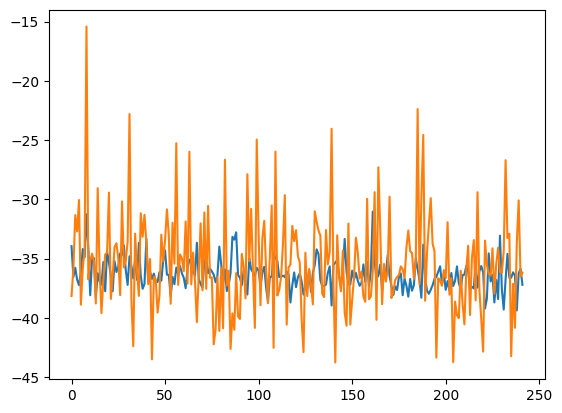

alpha 0.2 vae_lr 0.0005


In [38]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

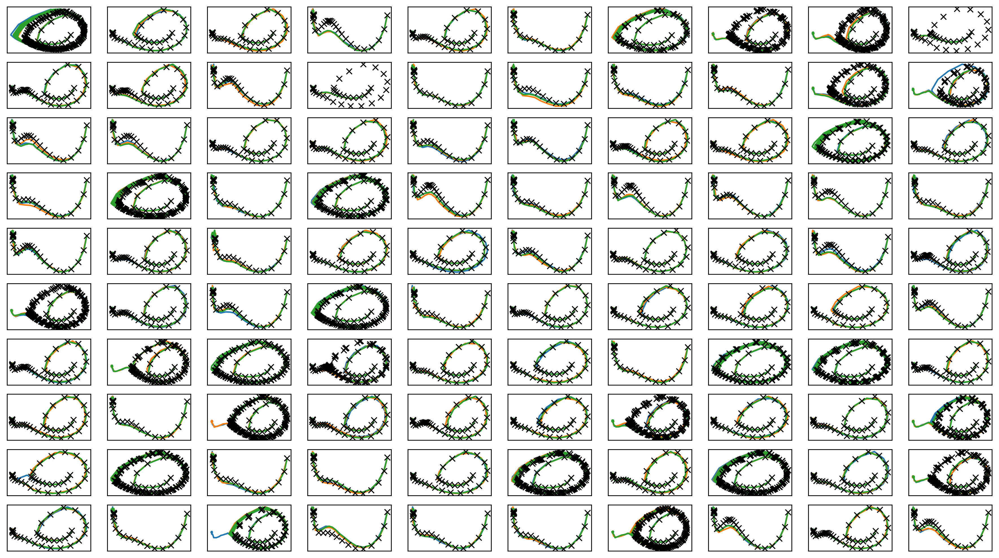

In [39]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter3.png")
plt.savefig("joint_iter3.eps")
plt.savefig("joint_iter3.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

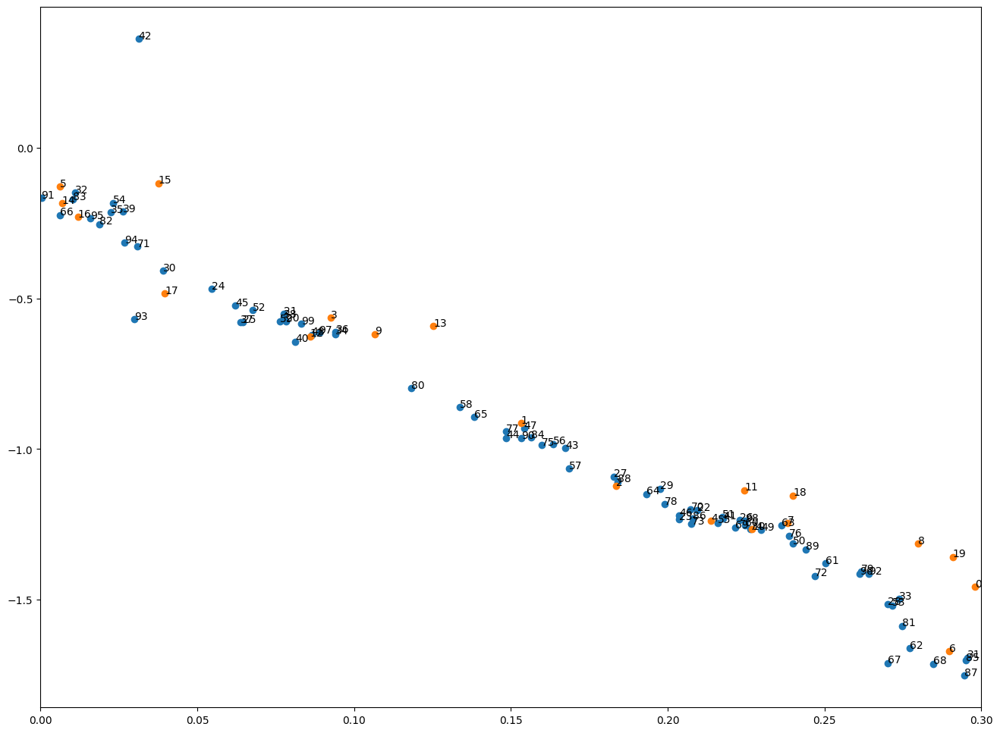

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [40]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent_iter3.png")
plt.savefig("damping_latent_iter3.eps")
plt.savefig("damping_latent_iter3.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [41]:
print(datetime.datetime.now())

2023-03-19 15:09:05.942717


# Iter 4

In [42]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [43]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)


train: iter 0  trainloss 0.08201  validloss 0.14775±0.00000  bestvalidloss 0.14775  last_update 0
train: iter 1  trainloss 0.05829  validloss 0.09302±0.00000  bestvalidloss 0.09302  last_update 0
train: iter 2  trainloss 0.05480  validloss 0.08295±0.00000  bestvalidloss 0.08295  last_update 0
train: iter 3  trainloss 0.05320  validloss 0.08469±0.00000  bestvalidloss 0.08295  last_update 1
train: iter 4  trainloss 0.05185  validloss 0.07659±0.00000  bestvalidloss 0.07659  last_update 0
train: iter 5  trainloss 0.06439  validloss 0.08858±0.00000  bestvalidloss 0.07659  last_update 1
train: iter 6  trainloss 0.04967  validloss 0.08120±0.00000  bestvalidloss 0.07659  last_update 2
train: iter 7  trainloss 0.04703  validloss 0.06738±0.00000  bestvalidloss 0.06738  last_update 0
train: iter 8  trainloss 0.05119  validloss 0.06970±0.00000  bestvalidloss 0.06738  last_update 1
train: iter 9  trainloss 0.06381  validloss 0.08898±0.00000  bestvalidloss 0.06738  last_update 2
train: iter 10  trai

train: iter 83  trainloss 0.03667  validloss 0.05061±0.00000  bestvalidloss 0.04610  last_update 2
train: iter 84  trainloss 0.03599  validloss 0.04942±0.00000  bestvalidloss 0.04610  last_update 3
train: iter 85  trainloss 0.03717  validloss 0.04707±0.00000  bestvalidloss 0.04610  last_update 4
train: iter 86  trainloss 0.04368  validloss 0.05309±0.00000  bestvalidloss 0.04610  last_update 5
train: iter 87  trainloss 0.03847  validloss 0.06487±0.00000  bestvalidloss 0.04610  last_update 6
train: iter 88  trainloss 0.03542  validloss 0.05145±0.00000  bestvalidloss 0.04610  last_update 7
train: iter 89  trainloss 0.03902  validloss 0.04715±0.00000  bestvalidloss 0.04610  last_update 8
train: iter 90  trainloss 0.03608  validloss 0.04737±0.00000  bestvalidloss 0.04610  last_update 9
train: iter 91  trainloss 0.03871  validloss 0.04754±0.00000  bestvalidloss 0.04610  last_update 10
train: iter 92  trainloss 0.03572  validloss 0.05228±0.00000  bestvalidloss 0.04610  last_update 11
train: i

train: iter 167  trainloss 0.03401  validloss 0.05153±0.00000  bestvalidloss 0.04495  last_update 22
train: iter 168  trainloss 0.03382  validloss 0.05146±0.00000  bestvalidloss 0.04495  last_update 23
train: iter 169  trainloss 0.03401  validloss 0.04977±0.00000  bestvalidloss 0.04495  last_update 24
train: iter 170  trainloss 0.03397  validloss 0.04700±0.00000  bestvalidloss 0.04495  last_update 25
train: iter 171  trainloss 0.03319  validloss 0.05528±0.00000  bestvalidloss 0.04495  last_update 26
train: iter 172  trainloss 0.03400  validloss 0.04628±0.00000  bestvalidloss 0.04495  last_update 27
train: iter 173  trainloss 0.03463  validloss 0.04882±0.00000  bestvalidloss 0.04495  last_update 28
train: iter 174  trainloss 0.03694  validloss 0.05949±0.00000  bestvalidloss 0.04495  last_update 29
train: iter 175  trainloss 0.03345  validloss 0.04579±0.00000  bestvalidloss 0.04495  last_update 30
train: iter 176  trainloss 0.03375  validloss 0.05328±0.00000  bestvalidloss 0.04495  last_

train: iter 251  trainloss 0.03901  validloss 0.05016±0.00000  bestvalidloss 0.04478  last_update 32
train: iter 252  trainloss 0.03443  validloss 0.04834±0.00000  bestvalidloss 0.04478  last_update 33
train: iter 253  trainloss 0.03524  validloss 0.06719±0.00000  bestvalidloss 0.04478  last_update 34
train: iter 254  trainloss 0.03294  validloss 0.04999±0.00000  bestvalidloss 0.04478  last_update 35
train: iter 255  trainloss 0.03429  validloss 0.06004±0.00000  bestvalidloss 0.04478  last_update 36
train: iter 256  trainloss 0.03490  validloss 0.05064±0.00000  bestvalidloss 0.04478  last_update 37
train: iter 257  trainloss 0.03359  validloss 0.04800±0.00000  bestvalidloss 0.04478  last_update 38
train: iter 258  trainloss 0.03347  validloss 0.05248±0.00000  bestvalidloss 0.04478  last_update 39
train: iter 259  trainloss 0.03285  validloss 0.04719±0.00000  bestvalidloss 0.04478  last_update 40
train: iter 260  trainloss 0.03663  validloss 0.04628±0.00000  bestvalidloss 0.04478  last_

In [44]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -163.33678307488563
valid_loss:  -179.92936633646488
train_loss:  -57.784313190802926
valid_loss:  -54.4278374749422


1e-08 1000.0


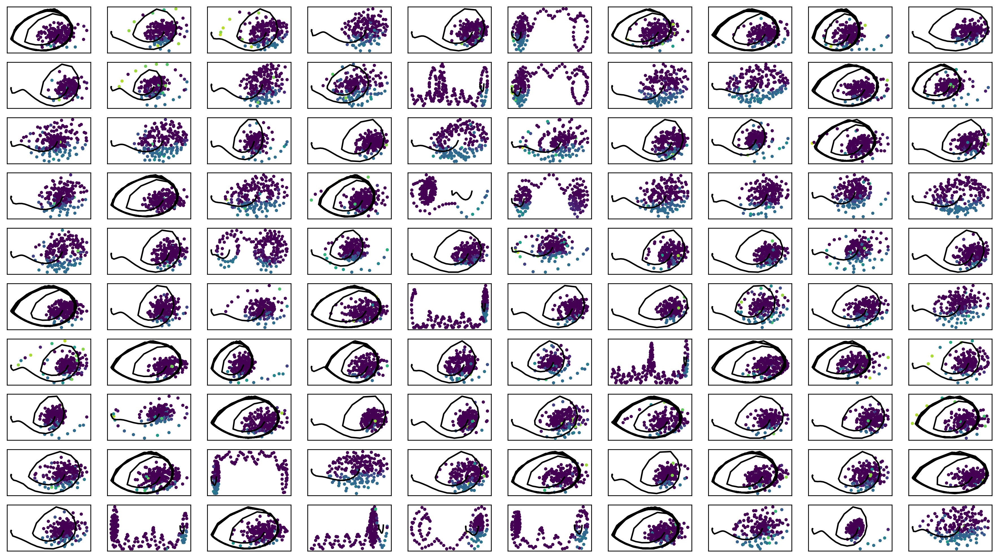

In [45]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter4.png")

In [46]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [47]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [48]:
# i = 35
# plt.plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1])
# plt.plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
# # plt.plot(simdata1b[i][:,0], simdata1b[i][:,1]) 
# plt.scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()),
#            # vmin=f(min_val), vmax=f(max_val)
#            )
# plt.colorbar()

train_weighted_vae: enc_dec
train: iter 0  trainloss -54.26630  validloss -58.59837±0.00000  bestvalidloss -58.59837  last_update 0
train: iter 1  trainloss -55.50739  validloss -52.46382±0.00000  bestvalidloss -58.59837  last_update 1
train: iter 2  trainloss -53.06734  validloss -39.70447±0.00000  bestvalidloss -58.59837  last_update 2
train: iter 3  trainloss -53.56535  validloss -50.34577±0.00000  bestvalidloss -58.59837  last_update 3
train: iter 4  trainloss -51.11338  validloss -56.75106±0.00000  bestvalidloss -58.59837  last_update 4
train: iter 5  trainloss -52.85710  validloss -61.11321±0.00000  bestvalidloss -61.11321  last_update 0
train: iter 6  trainloss -55.09556  validloss -57.83394±0.00000  bestvalidloss -61.11321  last_update 1
train: iter 7  trainloss -54.64508  validloss -58.79005±0.00000  bestvalidloss -61.11321  last_update 2
train: iter 8  trainloss -56.03596  validloss -56.37885±0.00000  bestvalidloss -61.11321  last_update 3
train: iter 9  trainloss -52.53239  

train: iter 78  trainloss -56.08704  validloss -59.18769±0.00000  bestvalidloss -66.26351  last_update 47
train: iter 79  trainloss -48.16845  validloss -46.63467±0.00000  bestvalidloss -66.26351  last_update 48
train: iter 80  trainloss -50.50585  validloss -51.71294±0.00000  bestvalidloss -66.26351  last_update 49
train: iter 81  trainloss -51.97215  validloss -59.94056±0.00000  bestvalidloss -66.26351  last_update 50
train: iter 82  trainloss -52.50383  validloss -55.70994±0.00000  bestvalidloss -66.26351  last_update 51
train: iter 83  trainloss -55.83965  validloss -52.08366±0.00000  bestvalidloss -66.26351  last_update 52
train: iter 84  trainloss -52.91934  validloss -56.37878±0.00000  bestvalidloss -66.26351  last_update 53
train: iter 85  trainloss -54.67543  validloss -52.77619±0.00000  bestvalidloss -66.26351  last_update 54
train: iter 86  trainloss -54.97047  validloss -46.48192±0.00000  bestvalidloss -66.26351  last_update 55
train: iter 87  trainloss -55.60945  validloss

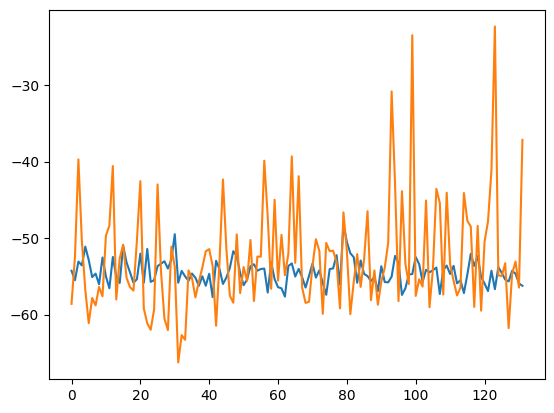

train_weighted_vae: enc
train: iter 0  trainloss -51.64682  validloss -49.10282±0.00000  bestvalidloss -49.10282  last_update 0
train: iter 1  trainloss -54.04026  validloss -38.69273±0.00000  bestvalidloss -49.10282  last_update 1
train: iter 2  trainloss -54.61061  validloss -45.01544±0.00000  bestvalidloss -49.10282  last_update 2
train: iter 3  trainloss -55.64024  validloss -55.92792±0.00000  bestvalidloss -55.92792  last_update 0
train: iter 4  trainloss -55.58237  validloss -46.47181±0.00000  bestvalidloss -55.92792  last_update 1
train: iter 5  trainloss -54.41455  validloss -56.25734±0.00000  bestvalidloss -56.25734  last_update 0
train: iter 6  trainloss -53.92874  validloss -59.89012±0.00000  bestvalidloss -59.89012  last_update 0
train: iter 7  trainloss -53.98135  validloss -55.05034±0.00000  bestvalidloss -59.89012  last_update 1
train: iter 8  trainloss -56.57855  validloss -55.53487±0.00000  bestvalidloss -59.89012  last_update 2
train: iter 9  trainloss -55.18962  vali

train: iter 78  trainloss -56.01372  validloss -53.54942±0.00000  bestvalidloss -61.21972  last_update 56
train: iter 79  trainloss -54.81083  validloss -53.34460±0.00000  bestvalidloss -61.21972  last_update 57
train: iter 80  trainloss -51.56605  validloss -52.73332±0.00000  bestvalidloss -61.21972  last_update 58
train: iter 81  trainloss -53.17193  validloss -47.47781±0.00000  bestvalidloss -61.21972  last_update 59
train: iter 82  trainloss -54.91199  validloss -48.43386±0.00000  bestvalidloss -61.21972  last_update 60
train: iter 83  trainloss -53.77654  validloss -56.71952±0.00000  bestvalidloss -61.21972  last_update 61
train: iter 84  trainloss -53.55810  validloss -52.26499±0.00000  bestvalidloss -61.21972  last_update 62
train: iter 85  trainloss -55.54212  validloss -53.50809±0.00000  bestvalidloss -61.21972  last_update 63
train: iter 86  trainloss -53.92443  validloss -54.53478±0.00000  bestvalidloss -61.21972  last_update 64
train: iter 87  trainloss -57.61069  validloss

train: iter 155  trainloss -56.54136  validloss -48.11183±0.00000  bestvalidloss -62.39335  last_update 30
train: iter 156  trainloss -56.49525  validloss -55.53520±0.00000  bestvalidloss -62.39335  last_update 31
train: iter 157  trainloss -56.03313  validloss -58.84402±0.00000  bestvalidloss -62.39335  last_update 32
train: iter 158  trainloss -52.84222  validloss -48.33724±0.00000  bestvalidloss -62.39335  last_update 33
train: iter 159  trainloss -57.63243  validloss -49.57931±0.00000  bestvalidloss -62.39335  last_update 34
train: iter 160  trainloss -56.60113  validloss -48.54056±0.00000  bestvalidloss -62.39335  last_update 35
train: iter 161  trainloss -52.50404  validloss -43.53562±0.00000  bestvalidloss -62.39335  last_update 36
train: iter 162  trainloss -54.62174  validloss -47.23217±0.00000  bestvalidloss -62.39335  last_update 37
train: iter 163  trainloss -54.89481  validloss -47.16788±0.00000  bestvalidloss -62.39335  last_update 38
train: iter 164  trainloss -55.46879 

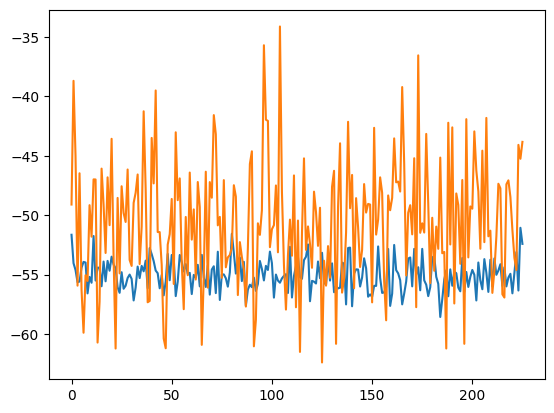

train_weighted_vae: dec
train: iter 0  trainloss -54.85926  validloss -52.28364±0.00000  bestvalidloss -52.28364  last_update 0
train: iter 1  trainloss -54.62690  validloss -56.88995±0.00000  bestvalidloss -56.88995  last_update 0
train: iter 2  trainloss -55.42698  validloss -54.80445±0.00000  bestvalidloss -56.88995  last_update 1
train: iter 3  trainloss -54.73249  validloss -51.33173±0.00000  bestvalidloss -56.88995  last_update 2
train: iter 4  trainloss -54.47150  validloss -60.80599±0.00000  bestvalidloss -60.80599  last_update 0
train: iter 5  trainloss -55.48264  validloss -55.47982±0.00000  bestvalidloss -60.80599  last_update 1
train: iter 6  trainloss -53.93747  validloss -48.52778±0.00000  bestvalidloss -60.80599  last_update 2
train: iter 7  trainloss -55.35718  validloss -50.90661±0.00000  bestvalidloss -60.80599  last_update 3
train: iter 8  trainloss -55.68857  validloss -52.17490±0.00000  bestvalidloss -60.80599  last_update 4
train: iter 9  trainloss -56.25752  vali

train: iter 78  trainloss -55.87393  validloss -51.17716±0.00000  bestvalidloss -60.80599  last_update 74
train: iter 79  trainloss -53.76980  validloss -56.48983±0.00000  bestvalidloss -60.80599  last_update 75
train: iter 80  trainloss -56.40246  validloss -51.84153±0.00000  bestvalidloss -60.80599  last_update 76
train: iter 81  trainloss -56.70509  validloss -50.10747±0.00000  bestvalidloss -60.80599  last_update 77
train: iter 82  trainloss -54.80088  validloss -38.29313±0.00000  bestvalidloss -60.80599  last_update 78
train: iter 83  trainloss -56.77520  validloss -43.79049±0.00000  bestvalidloss -60.80599  last_update 79
train: iter 84  trainloss -56.73317  validloss -49.09102±0.00000  bestvalidloss -60.80599  last_update 80
train: iter 85  trainloss -55.73398  validloss -50.21622±0.00000  bestvalidloss -60.80599  last_update 81
train: iter 86  trainloss -55.21372  validloss -51.84196±0.00000  bestvalidloss -60.80599  last_update 82
train: iter 87  trainloss -56.49378  validloss

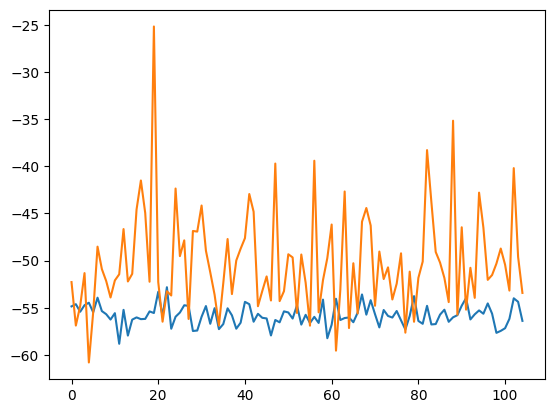

alpha 0.2 vae_lr 0.0005


In [49]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

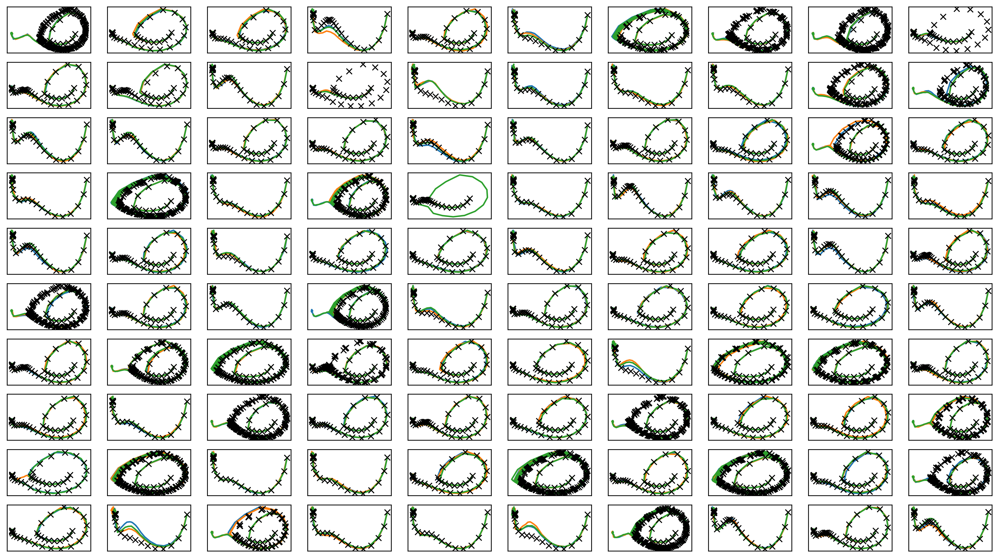

In [50]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter4.png")
plt.savefig("joint_iter4.eps")
plt.savefig("joint_iter4.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

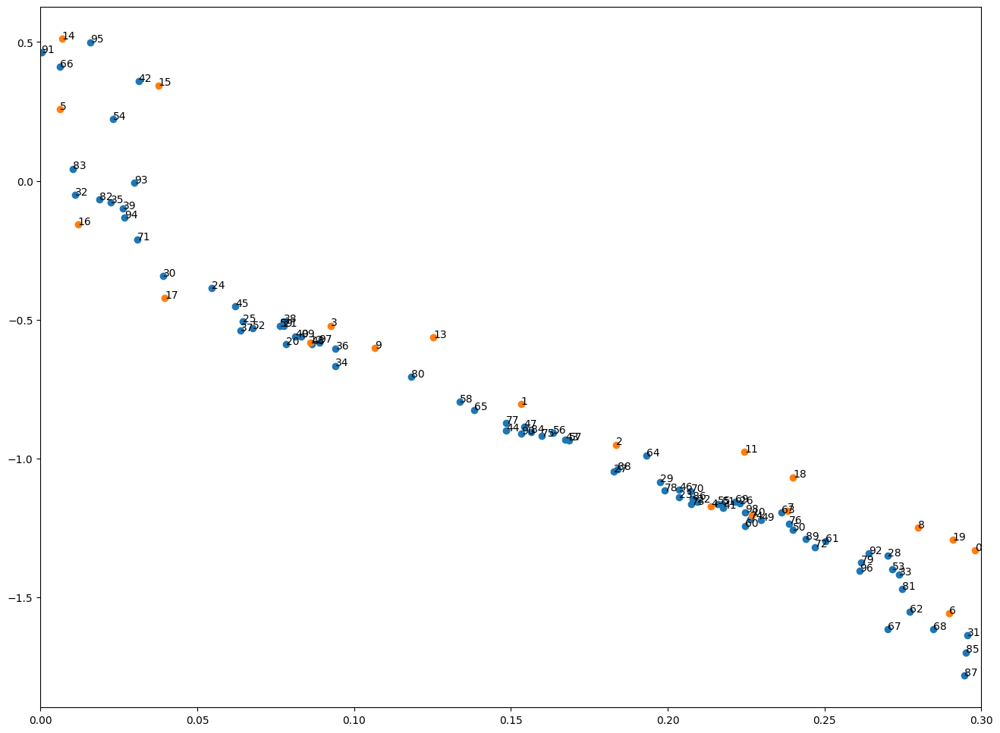

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [51]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent_iter4.png")
plt.savefig("damping_latent_iter4.eps")
plt.savefig("damping_latent_iter4.pdf")
plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])

# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [52]:
print(datetime.datetime.now())

2023-03-19 15:14:24.261824


# Iter5

In [53]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [54]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.03940  validloss 0.05342±0.00000  bestvalidloss 0.05342  last_update 0
train: iter 1  trainloss 0.03571  validloss 0.05436±0.00000  bestvalidloss 0.05342  last_update 1
train: iter 2  trainloss 0.03693  validloss 0.05186±0.00000  bestvalidloss 0.05186  last_update 0
train: iter 3  trainloss 0.03749  validloss 0.05429±0.00000  bestvalidloss 0.05186  last_update 1
train: iter 4  trainloss 0.03876  validloss 0.05865±0.00000  bestvalidloss 0.05186  last_update 2
train: iter 5  trainloss 0.03475  validloss 0.05731±0.00000  bestvalidloss 0.05186  last_update 3
train: iter 6  trainloss 0.03407  validloss 0.05109±0.00000  bestvalidloss 0.05109  last_update 0
train: iter 7  trainloss 0.03528  validloss 0.05129±0.00000  bestvalidloss 0.05109  last_update 1
train: iter 8  trainloss 0.03378  validloss 0.05584±0.00000  bestvalidloss 0.05109  last_update 2
train: iter 9  trainloss 0.03326  validloss 0.05562±0.00000  bestvalidloss 0.05109  last_update 3
train: iter 10  trai

train: iter 84  trainloss 0.03304  validloss 0.04852±0.00000  bestvalidloss 0.04791  last_update 38
train: iter 85  trainloss 0.03148  validloss 0.04879±0.00000  bestvalidloss 0.04791  last_update 39
train: iter 86  trainloss 0.04353  validloss 0.05472±0.00000  bestvalidloss 0.04791  last_update 40
train: iter 87  trainloss 0.03468  validloss 0.06212±0.00000  bestvalidloss 0.04791  last_update 41
train: iter 88  trainloss 0.03199  validloss 0.05339±0.00000  bestvalidloss 0.04791  last_update 42
train: iter 89  trainloss 0.03186  validloss 0.04936±0.00000  bestvalidloss 0.04791  last_update 43
train: iter 90  trainloss 0.03170  validloss 0.04828±0.00000  bestvalidloss 0.04791  last_update 44
train: iter 91  trainloss 0.03143  validloss 0.04829±0.00000  bestvalidloss 0.04791  last_update 45
train: iter 92  trainloss 0.03129  validloss 0.04903±0.00000  bestvalidloss 0.04791  last_update 46
train: iter 93  trainloss 0.03188  validloss 0.05157±0.00000  bestvalidloss 0.04791  last_update 47


train: iter 166  trainloss 0.03023  validloss 0.05173±0.00000  bestvalidloss 0.04655  last_update 22
train: iter 167  trainloss 0.02998  validloss 0.04709±0.00000  bestvalidloss 0.04655  last_update 23
train: iter 168  trainloss 0.03052  validloss 0.05168±0.00000  bestvalidloss 0.04655  last_update 24
train: iter 169  trainloss 0.03206  validloss 0.04845±0.00000  bestvalidloss 0.04655  last_update 25
train: iter 170  trainloss 0.03043  validloss 0.05015±0.00000  bestvalidloss 0.04655  last_update 26
train: iter 171  trainloss 0.04116  validloss 0.05350±0.00000  bestvalidloss 0.04655  last_update 27
train: iter 172  trainloss 0.03956  validloss 0.07470±0.00000  bestvalidloss 0.04655  last_update 28
train: iter 173  trainloss 0.03320  validloss 0.05328±0.00000  bestvalidloss 0.04655  last_update 29
train: iter 174  trainloss 0.03537  validloss 0.05017±0.00000  bestvalidloss 0.04655  last_update 30
train: iter 175  trainloss 0.03081  validloss 0.04745±0.00000  bestvalidloss 0.04655  last_

train: iter 249  trainloss 0.02952  validloss 0.04899±0.00000  bestvalidloss 0.04540  last_update 52
train: iter 250  trainloss 0.02943  validloss 0.04841±0.00000  bestvalidloss 0.04540  last_update 53
train: iter 251  trainloss 0.02965  validloss 0.04687±0.00000  bestvalidloss 0.04540  last_update 54
train: iter 252  trainloss 0.03011  validloss 0.04659±0.00000  bestvalidloss 0.04540  last_update 55
train: iter 253  trainloss 0.02937  validloss 0.04806±0.00000  bestvalidloss 0.04540  last_update 56
train: iter 254  trainloss 0.02949  validloss 0.04657±0.00000  bestvalidloss 0.04540  last_update 57
train: iter 255  trainloss 0.02995  validloss 0.05052±0.00000  bestvalidloss 0.04540  last_update 58
train: iter 256  trainloss 0.02969  validloss 0.04795±0.00000  bestvalidloss 0.04540  last_update 59
train: iter 257  trainloss 0.02974  validloss 0.04789±0.00000  bestvalidloss 0.04540  last_update 60
train: iter 258  trainloss 0.03233  validloss 0.04825±0.00000  bestvalidloss 0.04540  last_

In [55]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -144.00283103317022
valid_loss:  -179.04837889552118
train_loss:  -52.996470998525616
valid_loss:  -40.95952510237694


1e-08 1000.0


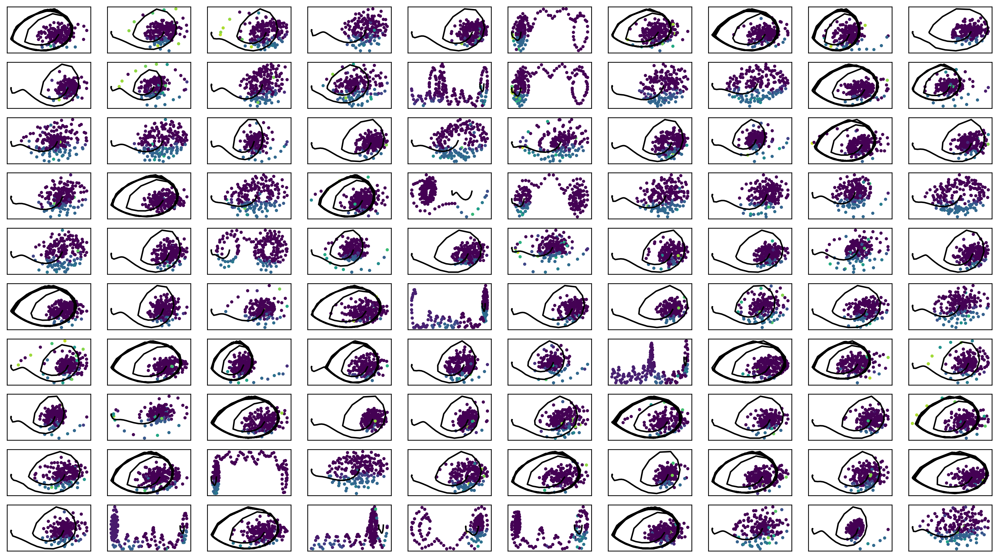

In [56]:
fig = plt.figure(figsize=(18,10), dpi=250)
ax_list = []
# min_val = min([iwvi.offlinedata_weight[i].min().numpy() for i in range(len(offline_data))])
# max_val = max([iwvi.offlinedata_weight[i].max().numpy() for i in range(len(offline_data))])
min_val = 1e-8
max_val = 1e3
print(min_val, max_val)

for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
    ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()), vmin=f(min_val), vmax=f(max_val), s=5) 
plt.savefig("weight_iter5.png")

In [57]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
# #     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


In [58]:
# fig = plt.figure(figsize=(18,10))
# print(min_val, max_val)
# for i in range(len(offline_data)):
#     ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
#     ax_list[-1].set_xticks([])
#     ax_list[-1].set_yticks([])
# #     ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"k-")
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"rx")
#     ax_list[-1].scatter(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1], c=f(iwvi.offlinedata_weight[i].numpy()/iwvi.offlinedata_weight[i].numpy().sum()), vmin=f(min_val), vmax=f(max_val), s=5) 


train_weighted_vae: enc_dec
train: iter 0  trainloss -52.21869  validloss -44.61607±0.00000  bestvalidloss -44.61607  last_update 0
train: iter 1  trainloss -51.27149  validloss -41.98155±0.00000  bestvalidloss -44.61607  last_update 1
train: iter 2  trainloss -50.08202  validloss -47.85536±0.00000  bestvalidloss -47.85536  last_update 0
train: iter 3  trainloss -51.96894  validloss -46.93437±0.00000  bestvalidloss -47.85536  last_update 1
train: iter 4  trainloss -54.32924  validloss -39.88267±0.00000  bestvalidloss -47.85536  last_update 2
train: iter 5  trainloss -51.72292  validloss -54.37392±0.00000  bestvalidloss -54.37392  last_update 0
train: iter 6  trainloss -53.54111  validloss -46.84305±0.00000  bestvalidloss -54.37392  last_update 1
train: iter 7  trainloss -49.85702  validloss -50.54912±0.00000  bestvalidloss -54.37392  last_update 2
train: iter 8  trainloss -50.85940  validloss -52.94532±0.00000  bestvalidloss -54.37392  last_update 3
train: iter 9  trainloss -52.19230  

train: iter 78  trainloss -53.83718  validloss -61.00472±0.00000  bestvalidloss -62.05428  last_update 58
train: iter 79  trainloss -52.17641  validloss -46.58788±0.00000  bestvalidloss -62.05428  last_update 59
train: iter 80  trainloss -53.60314  validloss -50.78926±0.00000  bestvalidloss -62.05428  last_update 60
train: iter 81  trainloss -51.13760  validloss -48.17046±0.00000  bestvalidloss -62.05428  last_update 61
train: iter 82  trainloss -51.57105  validloss -48.27887±0.00000  bestvalidloss -62.05428  last_update 62
train: iter 83  trainloss -53.19359  validloss -48.80470±0.00000  bestvalidloss -62.05428  last_update 63
train: iter 84  trainloss -53.82366  validloss -38.93683±0.00000  bestvalidloss -62.05428  last_update 64
train: iter 85  trainloss -55.28005  validloss -44.70816±0.00000  bestvalidloss -62.05428  last_update 65
train: iter 86  trainloss -45.15003  validloss -52.27436±0.00000  bestvalidloss -62.05428  last_update 66
train: iter 87  trainloss -51.83909  validloss

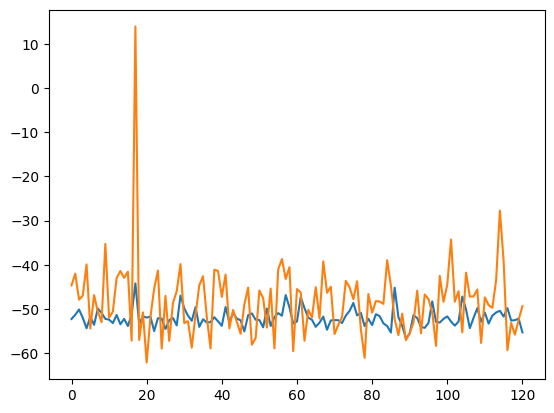

train_weighted_vae: enc
train: iter 0  trainloss -51.28572  validloss -41.01996±0.00000  bestvalidloss -41.01996  last_update 0
train: iter 1  trainloss -54.91734  validloss -52.52645±0.00000  bestvalidloss -52.52645  last_update 0
train: iter 2  trainloss -55.07005  validloss -47.21718±0.00000  bestvalidloss -52.52645  last_update 1
train: iter 3  trainloss -56.37501  validloss -54.21217±0.00000  bestvalidloss -54.21217  last_update 0
train: iter 4  trainloss -56.31225  validloss -50.98433±0.00000  bestvalidloss -54.21217  last_update 1
train: iter 5  trainloss -55.10185  validloss -57.43540±0.00000  bestvalidloss -57.43540  last_update 0
train: iter 6  trainloss -56.98767  validloss -43.39300±0.00000  bestvalidloss -57.43540  last_update 1
train: iter 7  trainloss -55.81150  validloss -46.34830±0.00000  bestvalidloss -57.43540  last_update 2
train: iter 8  trainloss -56.75004  validloss -52.88050±0.00000  bestvalidloss -57.43540  last_update 3
train: iter 9  trainloss -55.89284  vali

train: iter 78  trainloss -56.77208  validloss -43.00874±0.00000  bestvalidloss -66.62139  last_update 14
train: iter 79  trainloss -59.25675  validloss -40.96744±0.00000  bestvalidloss -66.62139  last_update 15
train: iter 80  trainloss -57.39434  validloss -50.62335±0.00000  bestvalidloss -66.62139  last_update 16
train: iter 81  trainloss -55.68818  validloss -48.11029±0.00000  bestvalidloss -66.62139  last_update 17
train: iter 82  trainloss -55.22361  validloss -55.08285±0.00000  bestvalidloss -66.62139  last_update 18
train: iter 83  trainloss -59.05151  validloss -58.95902±0.00000  bestvalidloss -66.62139  last_update 19
train: iter 84  trainloss -57.12388  validloss -56.02288±0.00000  bestvalidloss -66.62139  last_update 20
train: iter 85  trainloss -57.54164  validloss -39.80050±0.00000  bestvalidloss -66.62139  last_update 21
train: iter 86  trainloss -56.56105  validloss -48.26203±0.00000  bestvalidloss -66.62139  last_update 22
train: iter 87  trainloss -57.03738  validloss

train: iter 155  trainloss -56.48614  validloss -38.15097±0.00000  bestvalidloss -66.62139  last_update 91
train: iter 156  trainloss -56.17091  validloss -42.96376±0.00000  bestvalidloss -66.62139  last_update 92
train: iter 157  trainloss -57.76152  validloss -42.93616±0.00000  bestvalidloss -66.62139  last_update 93
train: iter 158  trainloss -60.00836  validloss -38.90202±0.00000  bestvalidloss -66.62139  last_update 94
train: iter 159  trainloss -56.33128  validloss -46.33517±0.00000  bestvalidloss -66.62139  last_update 95
train: iter 160  trainloss -58.08398  validloss -50.24152±0.00000  bestvalidloss -66.62139  last_update 96
train: iter 161  trainloss -57.09908  validloss -57.85908±0.00000  bestvalidloss -66.62139  last_update 97
train: iter 162  trainloss -59.21660  validloss -48.61561±0.00000  bestvalidloss -66.62139  last_update 98
train: iter 163  trainloss -54.58484  validloss -51.40867±0.00000  bestvalidloss -66.62139  last_update 99
train: iter 164  trainloss -56.78445 

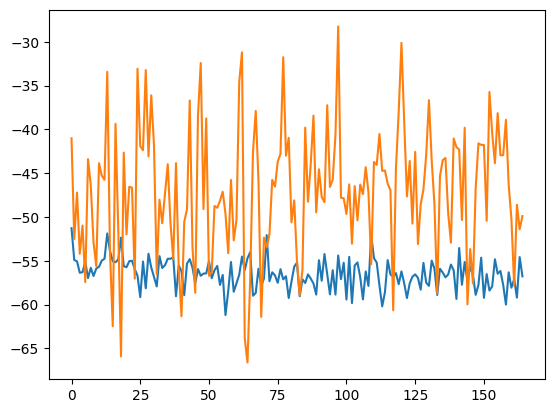

train_weighted_vae: dec
train: iter 0  trainloss -55.98865  validloss -44.57022±0.00000  bestvalidloss -44.57022  last_update 0
train: iter 1  trainloss -57.47252  validloss -50.93964±0.00000  bestvalidloss -50.93964  last_update 0
train: iter 2  trainloss -56.25099  validloss -48.00320±0.00000  bestvalidloss -50.93964  last_update 1
train: iter 3  trainloss -54.69000  validloss -47.58417±0.00000  bestvalidloss -50.93964  last_update 2
train: iter 4  trainloss -56.98332  validloss -37.45794±0.00000  bestvalidloss -50.93964  last_update 3
train: iter 5  trainloss -55.12952  validloss -45.59972±0.00000  bestvalidloss -50.93964  last_update 4
train: iter 6  trainloss -55.82434  validloss -35.71444±0.00000  bestvalidloss -50.93964  last_update 5
train: iter 7  trainloss -55.20860  validloss -47.68864±0.00000  bestvalidloss -50.93964  last_update 6
train: iter 8  trainloss -55.43085  validloss -23.09501±0.00000  bestvalidloss -50.93964  last_update 7
train: iter 9  trainloss -60.92944  vali

train: iter 78  trainloss -55.07720  validloss -49.73117±0.00000  bestvalidloss -58.76999  last_update 64
train: iter 79  trainloss -54.11202  validloss -32.78027±0.00000  bestvalidloss -58.76999  last_update 65
train: iter 80  trainloss -56.42843  validloss -51.28275±0.00000  bestvalidloss -58.76999  last_update 66
train: iter 81  trainloss -56.07975  validloss -44.01043±0.00000  bestvalidloss -58.76999  last_update 67
train: iter 82  trainloss -52.68646  validloss -54.09475±0.00000  bestvalidloss -58.76999  last_update 68
train: iter 83  trainloss -53.65352  validloss -50.79378±0.00000  bestvalidloss -58.76999  last_update 69
train: iter 84  trainloss -51.75906  validloss -47.29310±0.00000  bestvalidloss -58.76999  last_update 70
train: iter 85  trainloss -53.40473  validloss -40.96802±0.00000  bestvalidloss -58.76999  last_update 71
train: iter 86  trainloss -56.50983  validloss -46.25343±0.00000  bestvalidloss -58.76999  last_update 72
train: iter 87  trainloss -57.83445  validloss

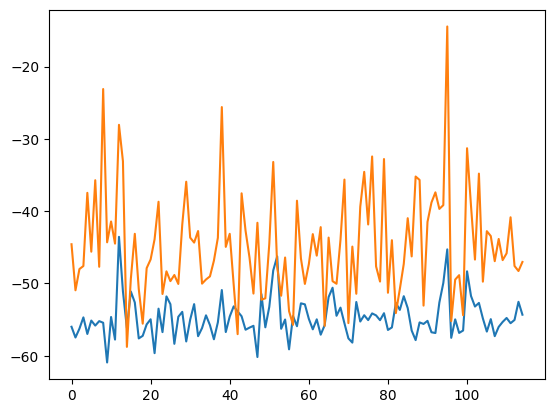

alpha 0.2 vae_lr 0.0005


In [59]:

train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=1)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()
train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=2)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()


train_curve, valid_curve = iwvi.train_weighted_vae(num_iter=num_iter_max, lr=vae_lr, early_stop_step=100, weight_alpha=alpha, flag=3)
iwvi.update_mulogvar_offlinedata()
plt.plot(train_curve)
plt.plot(valid_curve)
plt.show()

print("alpha",alpha, "vae_lr", vae_lr)
# plt.ylim([-2000, 1000])

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   
0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56

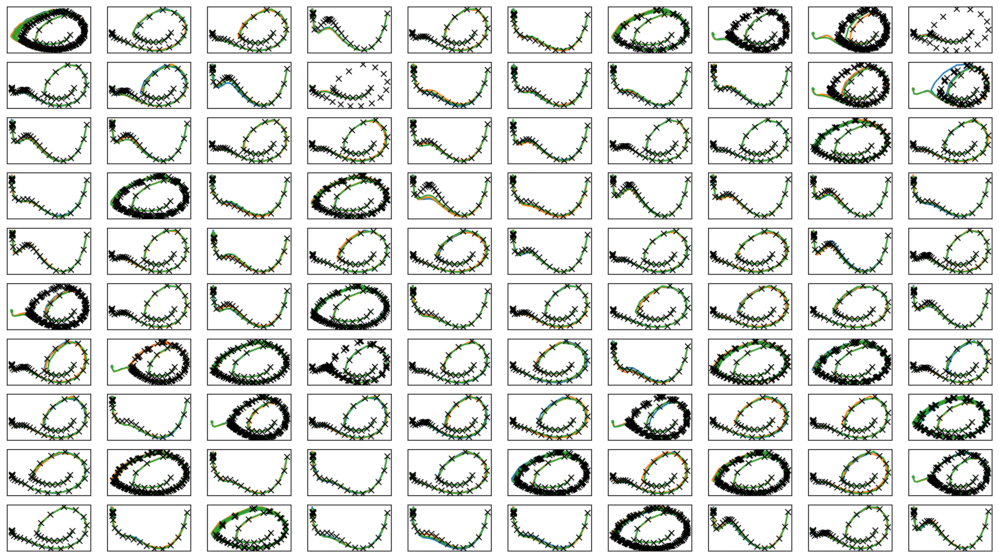

In [60]:
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0a = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0b = copy.deepcopy(iwvi.simenv_rolloutdata)
iwvi.get_sim_rollout_mdppolicy_data_fixlen()
simdata0c = copy.deepcopy(iwvi.simenv_rolloutdata)

fig = plt.figure(figsize=(18,10), dpi=250)
fig.patch.set_facecolor('white')
ax_list = []
for i in range(len(offline_data)):
    ax_list.append(fig.add_subplot(len(offline_data)//10, 10, i+1))
    ax_list[-1].set_xticks([])
    ax_list[-1].set_yticks([])
#     ax_list[-1].plot(iwvi.offline_data[i][:,0], iwvi.offline_data[i][:,1],"kx") 
#     ax_list[-1].plot(iwvi.simenv_rolloutdata[i][:,0], iwvi.simenv_rolloutdata[i][:,1],"o") 
    ax_list[-1].plot(simdata0a[i][:,0], simdata0a[i][:,1]) 
    ax_list[-1].plot(simdata0b[i][:,0], simdata0b[i][:,1]) 
    ax_list[-1].plot(simdata0c[i][:,0], simdata0c[i][:,1]) 
#     ax_list[-1].plot(simdata0d[i][:,0], simdata0d[i][:,1]) 
#     ax_list[-1].plot(simdata0e[i][:,0], simdata0e[i][:,1]) 

    ax_list[-1].plot(iwvi.debug_realenv_rolloutdata[i][:,0], iwvi.debug_realenv_rolloutdata[i][:,1],"kx") 
plt.savefig("joint_iter5.png")
plt.savefig("joint_iter5.eps")
plt.savefig("joint_iter5.pdf")

print("実環境方策rollout vs Sim環境方策rollout")

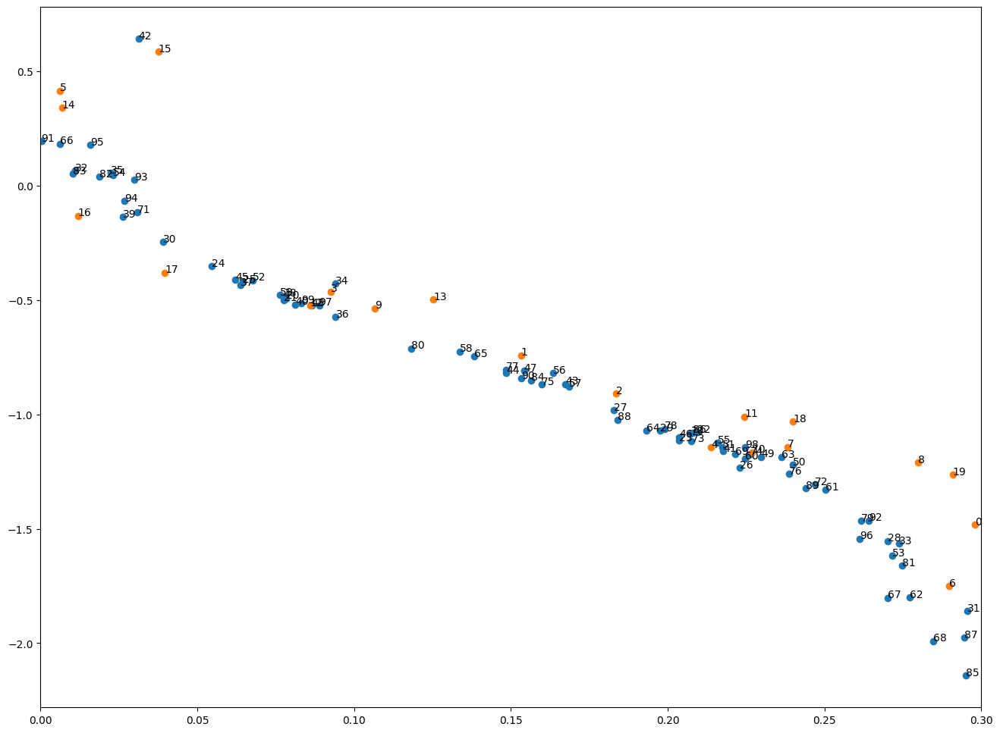

[0.29791016 0.15322083 0.18365987 0.09261918 0.21384459 0.00627838
 0.28977922 0.23826577 0.27982297 0.10656002]
[0.22693388 0.2244697  0.08596681 0.12522523 0.00685178 0.03757813
 0.01196297 0.03966669 0.24002473 0.29092061]
[0.07835583 0.07746172 0.20934208 0.20371297 0.05450337 0.06451795
 0.2229776  0.1828022  0.27007945 0.19762321]
[0.03898917 0.29555121 0.01093391 0.27386888 0.09397505 0.02248499
 0.09414549 0.06385285 0.07767223 0.02632497]
[0.08125716 0.21770374 0.03126921 0.1674378  0.14847363 0.06205282
 0.20363688 0.15417275 0.08645989 0.22978046]
[0.23991758 0.21743357 0.06757306 0.2714981  0.02319353 0.21589278
 0.16356097 0.16844176 0.13367955 0.07634676]
[0.22476822 0.25029279 0.2771417  0.23638723 0.19333075 0.13834196
 0.00632632 0.27019082 0.28455401 0.22163373]
[0.20737241 0.03096922 0.24692379 0.20760993 0.22644138 0.1598574
 0.23863549 0.1484238  0.19891706 0.26157098]
[0.11830818 0.27478066 0.01872246 0.01027625 0.15642099 0.29498274
 0.20786144 0.29459763 0.18393

In [61]:
plt.figure(figsize=(16,12))
np_mulogvar = iwvi.mulogvar_offlinedata.numpy()


plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
plt.xlim([0,0.3])
for i in range(len(debug_info)):
    plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
plt.savefig("damping_latent_iter5.png")
plt.savefig("damping_latent_iter5.eps")
plt.savefig("damping_latent_iter5.pdf")

plt.show()

# plt.figure(figsize=(16,12))
# plt.plot(debug_info[iwvi.validdata_num:,1], np_mulogvar[iwvi.validdata_num:,0], "o")
# plt.plot(debug_info[:iwvi.validdata_num,1], np_mulogvar[:iwvi.validdata_num,0], "o")
# plt.plot([bif_c, bif_c],[np_mulogvar[:,0].min(),np_mulogvar[:,0].max()])
# for i in range(len(debug_info)):
#     plt.annotate(str(i), xy=(debug_info[i,1],  np_mulogvar[i,0]))
# plt.xlim([0.06,0.14])
# plt.show()


for i in range(10):
    print(debug_info[i*10 : (i+1)*10,1])
# plt.show()
print("摩擦係数-潜在変数")

In [62]:
print(datetime.datetime.now())

2023-03-19 15:18:32.589405


# 評価関数計算

In [63]:
iwvi.get_sim_rollout_mdppolicy_data_randomstop()

0  1  2  3  4  5  6  7  8  9  10  11  12  13  14  15  16  17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36  37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56  57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76  77  78  79  80  81  82  83  84  85  86  87  88  89  90  91  92  93  94  95  96  97  98  99   


In [64]:
iwvi.train_ratio(num_iter=num_iter_max, lr=ratio_lr, early_stop_step=ratio_early, policy=agent.select_action)
iwvi.save()
# plt.plot(train_curve)
# plt.plot(valid_curve)

train: iter 0  trainloss 0.05963  validloss 0.05270±0.00000  bestvalidloss 0.05270  last_update 0
train: iter 1  trainloss 0.04455  validloss 0.05487±0.00000  bestvalidloss 0.05270  last_update 1
train: iter 2  trainloss 0.03765  validloss 0.05803±0.00000  bestvalidloss 0.05270  last_update 2
train: iter 3  trainloss 0.03596  validloss 0.05368±0.00000  bestvalidloss 0.05270  last_update 3
train: iter 4  trainloss 0.03479  validloss 0.05207±0.00000  bestvalidloss 0.05207  last_update 0
train: iter 5  trainloss 0.03462  validloss 0.05079±0.00000  bestvalidloss 0.05079  last_update 0
train: iter 6  trainloss 0.03384  validloss 0.05137±0.00000  bestvalidloss 0.05079  last_update 1
train: iter 7  trainloss 0.03359  validloss 0.05029±0.00000  bestvalidloss 0.05029  last_update 0
train: iter 8  trainloss 0.03388  validloss 0.05304±0.00000  bestvalidloss 0.05029  last_update 1
train: iter 9  trainloss 0.03621  validloss 0.05215±0.00000  bestvalidloss 0.05029  last_update 2
train: iter 10  trai

train: iter 84  trainloss 0.03265  validloss 0.05819±0.00000  bestvalidloss 0.04953  last_update 21
train: iter 85  trainloss 0.03328  validloss 0.05171±0.00000  bestvalidloss 0.04953  last_update 22
train: iter 86  trainloss 0.03111  validloss 0.05185±0.00000  bestvalidloss 0.04953  last_update 23
train: iter 87  trainloss 0.03092  validloss 0.05171±0.00000  bestvalidloss 0.04953  last_update 24
train: iter 88  trainloss 0.03205  validloss 0.05268±0.00000  bestvalidloss 0.04953  last_update 25
train: iter 89  trainloss 0.03090  validloss 0.05171±0.00000  bestvalidloss 0.04953  last_update 26
train: iter 90  trainloss 0.04381  validloss 0.05136±0.00000  bestvalidloss 0.04953  last_update 27
train: iter 91  trainloss 0.03340  validloss 0.06385±0.00000  bestvalidloss 0.04953  last_update 28
train: iter 92  trainloss 0.03138  validloss 0.05232±0.00000  bestvalidloss 0.04953  last_update 29
train: iter 93  trainloss 0.03128  validloss 0.05132±0.00000  bestvalidloss 0.04953  last_update 30


In [65]:
loss_list.append(iwvi.eval_loss(weight_alpha=1.))
normalized_loss_list.append(iwvi.eval_loss(weight_alpha=alpha))


train_loss:  -156.92879999488594
valid_loss:  -276.6021887391806
train_loss:  -54.398286041617396
valid_loss:  -44.67217142343521


In [66]:
loss_array = np.array(loss_list)

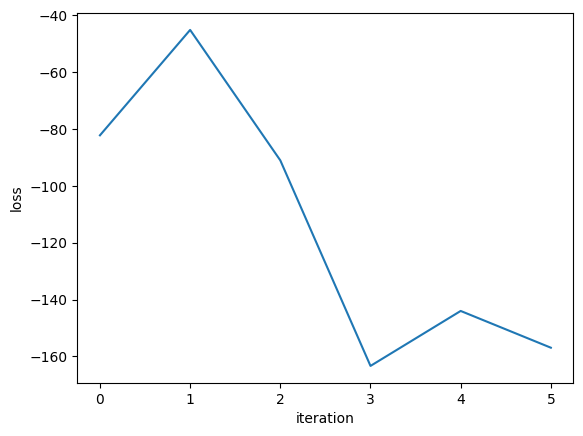

In [68]:
plt.plot(loss_array[:,0])
plt.xlabel("iteration")
plt.ylabel("loss")
plt.savefig("policy_evaluartion_learning_curve.png")
plt.savefig("policy_evaluartion_learning_curve.eps")
plt.savefig("policy_evaluartion_learning_curve.pdf")